<a href="https://colab.research.google.com/github/MehrdadGh1989/Diabete_Project/blob/main/Wind%20Turbine%20Thesis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

# ImPorting the DataSet:

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
WindT=pd.read_csv('/content/drive/MyDrive/Kelmarsh Wind Turbine/T1_Kelmarsh_2020.csv')

In [4]:
WindT

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)","Wind speed, Minimum (m/s)","Wind speed, Maximum (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),"Wind speed Sensor 1, Standard deviation (m/s)","Wind speed Sensor 1, Minimum (m/s)","Wind speed Sensor 1, Maximum (m/s)",...,Tower Acceleration y (mm/ss),"Tower Acceleration X, Min (mm/ss)","Tower Acceleration X, Max (mm/ss)","Tower Acceleration Y, Min (mm/ss)","Tower Acceleration Y, Max (mm/ss)","Drive train acceleration, Max (mm/ss)","Drive train acceleration, Min (mm/ss)","Drive train acceleration, StdDev (mm/ss)","Tower Acceleration X, StdDev (mm/ss)","Tower Acceleration Y, StdDev (mm/ss)"
0,01/01/2020 00:00,3.887291,0.646663,2.629255,5.138163,7.1,4.390778,0.595037,2.894442,5.923776,...,30.390030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01/01/2020 00:10,3.848941,0.787454,2.456995,5.551735,7.1,4.216298,0.686900,3.387660,5.713417,...,32.042564,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01/01/2020 00:20,4.043625,0.983279,2.726894,6.251913,7.1,4.323125,1.053373,3.305274,6.688592,...,32.799056,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2020 00:30,3.330342,0.689929,1.541864,4.689322,7.1,3.584192,0.524914,2.547872,4.671783,...,36.129912,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01/01/2020 00:40,3.388536,0.897104,1.832924,5.210185,7.1,3.668500,0.885085,1.908008,5.278419,...,26.667582,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52699,31/12/2020 23:10,5.119444,0.138374,4.902000,5.344500,7.0,4.815071,0.172836,4.544675,5.144063,...,4.464453,1.627771,9.191845,1.356082,8.504202,4.037867,4.037867,0.0,1.996142,2.033033
52700,31/12/2020 23:20,5.009681,0.145155,4.666500,5.300250,7.0,4.759028,0.192205,4.351247,5.136302,...,4.589267,1.432424,8.505324,1.326892,9.036353,4.049649,4.049649,0.0,2.148482,1.780293
52701,31/12/2020 23:30,5.060813,0.089126,4.891875,5.250000,7.0,4.825727,0.199880,4.456916,5.103168,...,4.916669,1.713095,8.629942,1.569391,9.103714,4.014544,4.014544,0.0,1.604888,1.733586
52702,31/12/2020 23:40,4.814269,0.278785,4.128750,5.164500,7.0,4.740983,0.149325,4.372440,4.985261,...,4.877768,1.746775,10.369538,1.847816,9.026249,4.050445,4.050445,0.0,1.963136,1.998647


# Adding Month and Some Modification to the DataSet

In [5]:
# Check Whether this is Necessary Or Not
# Define the date parser function to parse the custom date format
def custom_date_parser(date_str):
    return pd.to_datetime(date_str, format="%d/%m/%Y %H:%M")

In [6]:
#No necessary to Execute this code
#Specify the file path to your CSV file
file_path = '/content/drive/MyDrive/Kelmarsh Wind Turbine/T1_Kelmarsh_2020.csv'  # Replace with your actual file path
# Read the CSV file with the custom date parser
WindT = pd.read_csv(file_path, parse_dates=['Date and time'], date_parser=custom_date_parser)

In [7]:
#How TO Add Month
WindT['Date and time'] = pd.to_datetime(WindT['Date and time'])
WindT['Month'] = WindT['Date and time'].dt.month

In [8]:
WindT.head(180)

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)","Wind speed, Minimum (m/s)","Wind speed, Maximum (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),"Wind speed Sensor 1, Standard deviation (m/s)","Wind speed Sensor 1, Minimum (m/s)","Wind speed Sensor 1, Maximum (m/s)",...,"Tower Acceleration X, Min (mm/ss)","Tower Acceleration X, Max (mm/ss)","Tower Acceleration Y, Min (mm/ss)","Tower Acceleration Y, Max (mm/ss)","Drive train acceleration, Max (mm/ss)","Drive train acceleration, Min (mm/ss)","Drive train acceleration, StdDev (mm/ss)","Tower Acceleration X, StdDev (mm/ss)","Tower Acceleration Y, StdDev (mm/ss)",Month
0,2020-01-01 00:00:00,3.887291,0.646663,2.629255,5.138163,7.1,4.390778,0.595037,2.894442,5.923776,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1,2020-01-01 00:10:00,3.848941,0.787454,2.456995,5.551735,7.1,4.216298,0.686900,3.387660,5.713417,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
2,2020-01-01 00:20:00,4.043625,0.983279,2.726894,6.251913,7.1,4.323125,1.053373,3.305274,6.688592,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
3,2020-01-01 00:30:00,3.330342,0.689929,1.541864,4.689322,7.1,3.584192,0.524914,2.547872,4.671783,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
4,2020-01-01 00:40:00,3.388536,0.897104,1.832924,5.210185,7.1,3.668500,0.885085,1.908008,5.278419,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,2020-01-02 05:10:00,7.476165,1.123796,5.774856,10.122564,7.1,7.859572,1.082863,6.315383,9.886542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
176,2020-01-02 05:20:00,7.749814,1.034874,5.711372,9.587594,7.1,8.167888,1.041701,6.330762,9.380143,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
177,2020-01-02 05:30:00,7.426232,0.950074,5.525376,8.835442,7.1,7.838934,0.764522,6.447476,9.326591,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
178,2020-01-02 05:40:00,7.842700,1.140748,6.202165,10.070219,7.1,8.352748,1.129923,6.026209,10.478073,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1


# Working On Specific DataSet

In [9]:
#Wind Specific Columns
Wind_SC=WindT[['Date and time','Wind speed (m/s)','Wind direction (°)','Nacelle position (°)','Power (kW)', 'Potential power MPC (kW)' , 'Power factor (cosphi)'
              ,'Ambient temperature (converter) (°C)','Rotor speed (RPM)','Gearbox speed (RPM)','Blade angle (pitch position) A (°)','Month']]

In [10]:
Wind_SC.head(180)

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
175,2020-01-02 05:10:00,7.476165,186.086584,194.829453,859.103744,804.039169,-0.945205,9.0775,13.550037,1610.236839,0.042999,1
176,2020-01-02 05:20:00,7.749814,187.013979,194.829453,968.880920,895.437712,-0.951243,9.0650,14.040431,1665.672112,0.000000,1
177,2020-01-02 05:30:00,7.426232,189.723648,194.829453,881.611887,787.361497,-0.939148,9.0950,13.660394,1625.691965,0.000000,1
178,2020-01-02 05:40:00,7.842700,192.303292,194.105767,1070.105585,926.461889,-0.946729,9.1450,14.489645,1719.178442,0.000000,1


In [ ]:
Wind_SC.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52704 entries, 0 to 52703
Data columns (total 12 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   Date and time                         52704 non-null  datetime64[ns]
 1   Wind speed (m/s)                      52236 non-null  float64       
 2   Wind direction (°)                    52236 non-null  float64       
 3   Nacelle position (°)                  52236 non-null  float64       
 4   Power (kW)                            52236 non-null  float64       
 5   Potential power MPC (kW)              52236 non-null  float64       
 6   Power factor (cosphi)                 52236 non-null  float64       
 7   Ambient temperature (converter) (°C)  52236 non-null  float64       
 8   Rotor speed (RPM)                     52236 non-null  float64       
 9   Gearbox speed (RPM)                   51982 non-null  float64       
 10

<ipython-input-12-209f27d0795c>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = Wind_SC.corr()


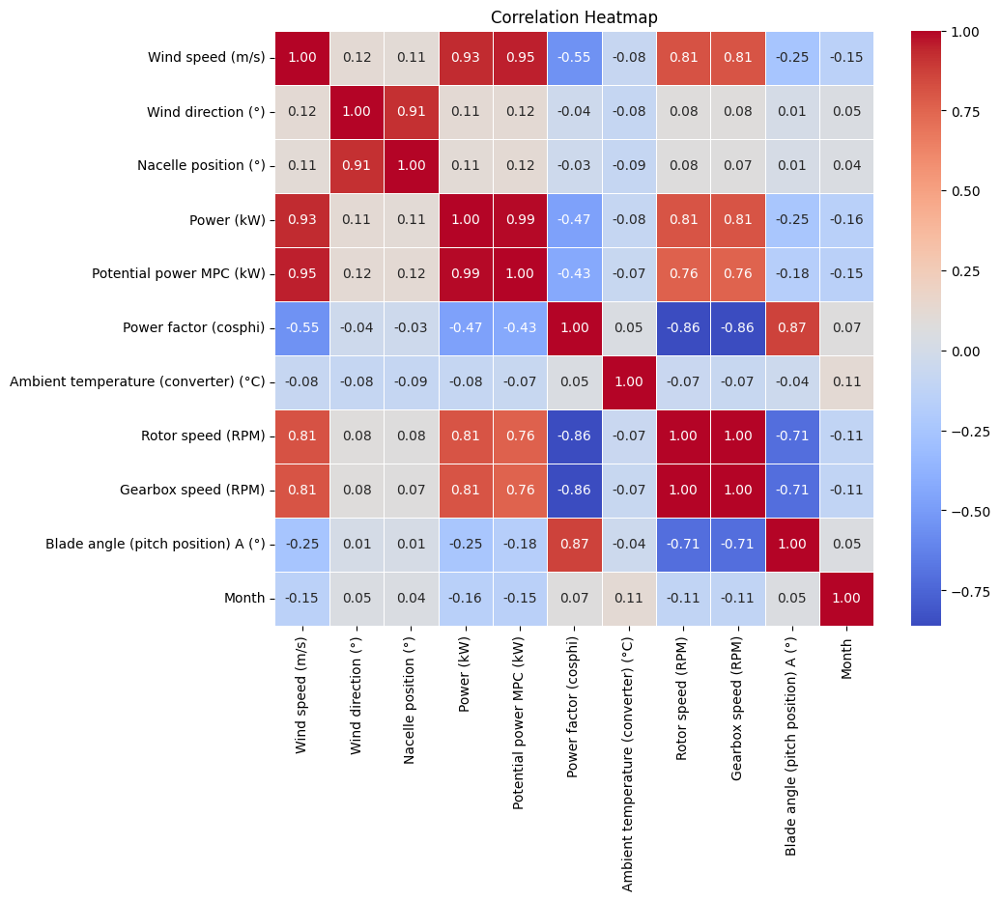

In [ ]:
# Calculate the correlation matrix
corr_matrix = Wind_SC.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

In [ ]:
# To find the name of the Columns
#To see the Columns
Columns_Name=WindT.columns
for name in Columns_Name:
    print(name)

Date and time
Wind speed (m/s)
Wind speed, Standard deviation (m/s)
Wind speed, Minimum (m/s)
Wind speed, Maximum (m/s)
Long Term Wind (m/s)
Wind speed Sensor 1 (m/s)
Wind speed Sensor 1, Standard deviation (m/s)
Wind speed Sensor 1, Minimum (m/s)
Wind speed Sensor 1, Maximum (m/s)
Wind speed Sensor 2 (m/s)
Wind speed Sensor 2, Standard deviation (m/s)
Wind speed Sensor 2, Minimum (m/s)
Wind speed Sensor 2, Maximum (m/s)
Density adjusted wind speed (m/s)
Wind direction (°)
Nacelle position (°)
Wind direction, Standard deviation (°)
Wind direction, Minimum (°)
Wind direction, Maximum (°)
Nacelle position, Standard deviation (°)
Nacelle position, Minimum (°)
Nacelle position, Maximum (°)
Vane position 1+2 (°)
Vane position 1+2, Max (°)
Vane position 1+2, Min (°)
Vane position 1+2, StdDev (°)
Energy Export (kWh)
Energy Export counter (kWh)
Energy Import (kWh)
Energy Import counter (kWh)
Lost Production (Contractual) (kWh)
Lost Production (Time-based IEC B.2.2) (kWh)
Lost Production (Time-

# Density of Air

In [ ]:
#AD= Air Density
WindT_AD=WindT[['Date and time','Wind speed (m/s)','Density adjusted wind speed (m/s)']]

In [ ]:
WindT_AD

,Date and time,Wind speed (m/s),Density adjusted wind speed (m/s)
0,2020-01-01 00:00:00,3.887291,3.890319
1,2020-01-01 00:10:00,3.848941,3.851538
2,2020-01-01 00:20:00,4.043625,4.046281
3,2020-01-01 00:30:00,3.330342,3.332758
4,2020-01-01 00:40:00,3.388536,3.391407
...,...,...,...
52699,2020-12-31 23:10:00,5.119444,5.153822
52700,2020-12-31 23:20:00,5.009681,5.043628
52701,2020-12-31 23:30:00,5.060813,5.094797
52702,2020-12-31 23:40:00,4.814269,4.846333


In [ ]:
start_datetime = '2020-12-31 04:40:00'
end_datetime = '2020-12-31 04:50:00'

selected_rows = Wind_SC[(Wind_SC['Date and time'] >= start_datetime) & (Wind_SC['Date and time'] <= end_datetime)]

selected_rows

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°)
52588,2020-12-31 04:40:00,4.38013,286.593412,287.544722,27.475366,136.194376,0.512879,1.7375,3.659108,433.821099,52.571499
52589,2020-12-31 04:50:00,4.81695,288.325644,288.121399,-0.695151,184.681455,1.000000,1.7150,0.000000,4.199280,89.989998


In [ ]:
# Define the reference air density at standard conditions
rho_0 = 1.225  # kg/m³ (standard air density at sea level and 15°C)

# Calculate air density for each row in the dataset
WindT_AD['Air Density (kg/m³)'] = (WindT_AD['Density adjusted wind speed (m/s)'] / WindT_AD['Wind speed (m/s)'])**2 * rho_0
WindT_AD

<ipython-input-12-25def1f38f0b>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  WindT_AD['Air Density (kg/m³)'] = (WindT_AD['Density adjusted wind speed (m/s)'] / WindT_AD['Wind speed (m/s)'])**2 * rho_0


,Date and time,Wind speed (m/s),Density adjusted wind speed (m/s),Air Density (kg/m³)
0,2020-01-01 00:00:00,3.887291,3.890319,1.226909
1,2020-01-01 00:10:00,3.848941,3.851538,1.226654
2,2020-01-01 00:20:00,4.043625,4.046281,1.226610
3,2020-01-01 00:30:00,3.330342,3.332758,1.226778
4,2020-01-01 00:40:00,3.388536,3.391407,1.227077
...,...,...,...,...
52699,2020-12-31 23:10:00,5.119444,5.153822,1.241507
52700,2020-12-31 23:20:00,5.009681,5.043628,1.241658
52701,2020-12-31 23:30:00,5.060813,5.094797,1.241507
52702,2020-12-31 23:40:00,4.814269,4.846333,1.241372


# Wind Directionv-Speed Category

In [11]:
#WIND Direction Category

#SD=Speed-Direction
Wind_SD=WindT[['Date and time','Wind speed (m/s)','Wind direction (°)','Nacelle position (°)']]

In [12]:
import pandas as pd
import numpy as np  # Import numpy for NaN handling

# Assuming 'Wind_SD' is your DataFrame and 'Wind direction (°)' is the column with wind direction data
# You can load your dataset using pd.read_csv() or any other method

# Create a dictionary to map wind direction degrees to categories
wind_direction_categories = {
    'N': list(range(349, 360)) + list(range(0, 11)),
    'NNE': list(range(11, 34)),
    'NE': list(range(34, 56)),
    'ENE': list(range(56, 79)),
    'E': list(range(79, 101)),
    'ESE': list(range(101, 124)),
    'SE': list(range(124, 146)),
    'SSE': list(range(146, 169)),
    'S': list(range(169, 191)),
    'SSW': list(range(191, 214)),
    'SW': list(range(214, 236)),
    'WSW': list(range(236, 259)),
    'W': list(range(259, 281)),
    'WNW': list(range(281, 304)),
    'NW': list(range(304, 326)),
    'NNW': list(range(326, 349))
}

# Function to categorize wind direction
def categorize_wind_direction(degrees):
    if np.isnan(degrees):  # Check for NaN values
        return 'Unknown'

    for category, degree_range in wind_direction_categories.items():
        if int(degrees) in degree_range:
            return category
    return 'Unknown'  # Return 'Unknown' if the direction doesn't match any category

# Apply the categorization function to the DataFrame
Wind_SD['Wind Category'] = Wind_SD['Wind direction (°)'].apply(categorize_wind_direction)

# Now, 'Wind Category' column will contain the categorized wind directions


<ipython-input-12-36c722107a7a>:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Wind_SD['Wind Category'] = Wind_SD['Wind direction (°)'].apply(categorize_wind_direction)


In [13]:
Wind_SD

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Wind Category
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,ESE
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,ESE
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,ESE
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,ESE
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,ESE
...,...,...,...,...,...
52699,2020-12-31 23:10:00,5.119444,303.499764,313.365387,WNW
52700,2020-12-31 23:20:00,5.009681,304.460909,313.365387,NW
52701,2020-12-31 23:30:00,5.060813,300.909886,313.365387,WNW
52702,2020-12-31 23:40:00,4.814269,297.398429,313.365387,WNW


In [14]:
wind_category_counts = Wind_SD['Wind Category'].value_counts()
# Display the frequency counts
print(wind_category_counts)

WSW        7716
SW         6844
SSW        6155
NE         4294
WNW        4004
W          3834
S          3472
NNW        2250
ENE        2028
NNE        1984
NW         1919
SSE        1883
E          1632
N          1612
SE         1535
ESE        1074
Unknown     468
Name: Wind Category, dtype: int64


In [15]:
average_wind_speeds = Wind_SD.groupby('Wind Category')['Wind speed (m/s)'].mean()

# Display the average wind speeds related to each wind direction category
print(average_wind_speeds)

Wind Category
E          4.382174
ENE        4.714361
ESE        3.532629
N          5.147756
NE         6.118763
NNE        5.408712
NNW        4.751985
NW         4.579761
S          6.810057
SE         4.917382
SSE        6.081551
SSW        7.573256
SW         8.331746
Unknown         NaN
W          6.480026
WNW        5.992020
WSW        7.828157
Name: Wind speed (m/s), dtype: float64


In [16]:
wind_category_counts = Wind_SD['Wind Category'].value_counts()
# Display the frequency counts
print(wind_category_counts)

WSW        7716
SW         6844
SSW        6155
NE         4294
WNW        4004
W          3834
S          3472
NNW        2250
ENE        2028
NNE        1984
NW         1919
SSE        1883
E          1632
N          1612
SE         1535
ESE        1074
Unknown     468
Name: Wind Category, dtype: int64


In [18]:
# TO SEE THE UNKNOWN VALUES-------


# Assuming 'Wind_SD' is your DataFrame and 'Wind direction (°)' is the column with wind direction data
# You can load your dataset using pd.read_csv() or any other method

# Create a dictionary to map wind direction degrees to categories
wind_direction_categories = {
    'N': list(range(349, 360)) + list(range(0, 11)),
    'NNE': list(range(11, 34)),
    'NE': list(range(34, 56)),
    'ENE': list(range(56, 79)),
    'E': list(range(79, 101)),
    'ESE': list(range(101, 124)),
    'SE': list(range(124, 146)),
    'SSE': list(range(146, 169)),
    'S': list(range(169, 191)),
    'SSW': list(range(191, 214)),
    'SW': list(range(214, 236)),
    'WSW': list(range(236, 259)),
    'W': list(range(259, 281)),
    'WNW': list(range(281, 304)),
    'NW': list(range(304, 326)),
    'NNW': list(range(326, 349))
}

# Function to categorize wind direction
def categorize_wind_direction(degrees):
    if np.isnan(degrees):  # Check for NaN values
        return 'Unknown'

    for category, degree_range in wind_direction_categories.items():
        if int(degrees) in degree_range:
            return category
    return 'Unknown'  # Return 'Unknown' if the direction doesn't match any category

# Apply the categorization function to the DataFrame
Wind_SD['Wind Category'] = Wind_SD['Wind direction (°)'].apply(categorize_wind_direction)

# Filter and print the rows with 'Unknown' wind direction
unknown_wind_directions = Wind_SD[Wind_SD['Wind Category'] == 'Unknown']
print(unknown_wind_directions)





            Date and time  Wind speed (m/s)  Wind direction (°)  \
1011  2020-01-08 00:30:00               NaN                 NaN   
1071  2020-01-08 10:30:00               NaN                 NaN   
1072  2020-01-08 10:40:00               NaN                 NaN   
1073  2020-01-08 10:50:00               NaN                 NaN   
1074  2020-01-08 11:00:00               NaN                 NaN   
...                   ...               ...                 ...   
42262 2020-10-20 11:40:00               NaN                 NaN   
42263 2020-10-20 11:50:00               NaN                 NaN   
42264 2020-10-20 12:00:00               NaN                 NaN   
42265 2020-10-20 12:10:00               NaN                 NaN   
45139 2020-11-09 11:10:00               NaN                 NaN   

       Nacelle position (°) Wind Category  
1011                    NaN       Unknown  
1071                    NaN       Unknown  
1072                    NaN       Unknown  
1073               

<ipython-input-18-9c2944ded460>:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Wind_SD['Wind Category'] = Wind_SD['Wind direction (°)'].apply(categorize_wind_direction)


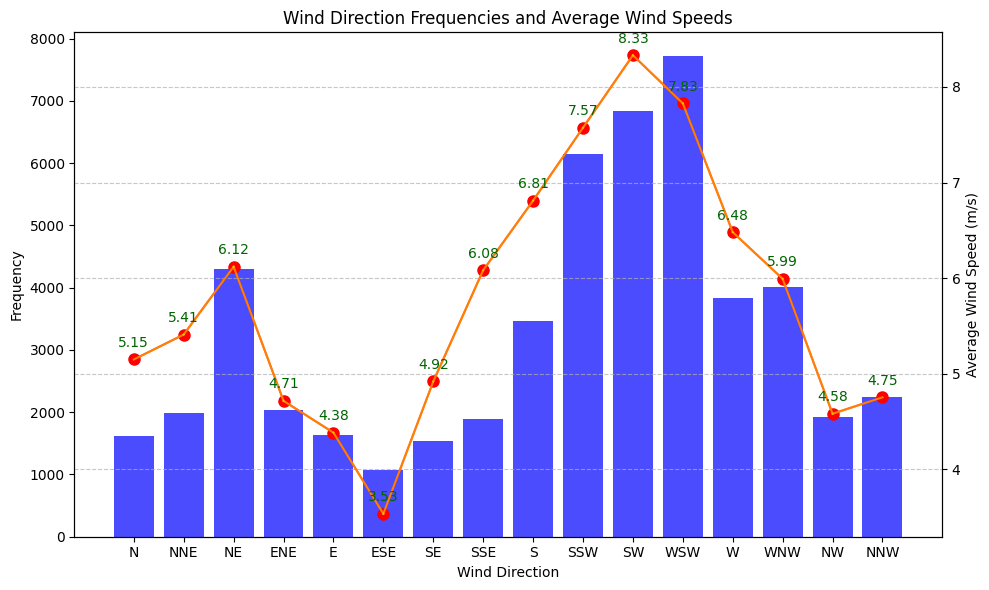

In [19]:
import matplotlib.pyplot as plt

wind_speed_counts = {
    'N': 1612,
    'NNE': 1984,
    'NE': 4294,
    'ENE': 2028,
    'E': 1632,
    'ESE': 1074,
    'SE': 1535,
    'SSE': 1883,
    'S': 3472,
    'SSW': 6155,
    'SW': 6844,
    'WSW': 7716,
    'W': 3834,
    'WNW': 4004,
    'NW': 1919,
    'NNW': 2250,
}

average_wind_speeds = {
    'N': 5.147756,
    'NNE': 5.408712,
    'NE': 6.118763,
    'ENE': 4.714361,
    'E': 4.382174,
    'ESE': 3.532629,
    'SE': 4.917382,
    'SSE': 6.081551,
    'S': 6.810057,
    'SSW': 7.573256,
    'SW': 8.331746,
    'WSW': 7.828157,
    'W': 6.480026,
    'WNW': 5.992020,
    'NW': 4.579761,
    'NNW': 4.751985,
}
# Data
wind_directions = list(wind_speed_counts.keys())
frequency = list(wind_speed_counts.values())
average_wind_speeds = list(average_wind_speeds.values())  # Corrected

# Create a figure with subplots
fig, ax1 = plt.subplots(figsize=(10, 6))

# Create vertical bars for frequency on the left Y-axis
ax1.bar(wind_directions, frequency, color='blue', alpha=0.7)
ax1.set_ylabel('Frequency')
ax1.set_xlabel('Wind Direction')

# Create a twin Axes for the dot plot on the right Y-axis
ax2 = ax1.twinx()
ax2.plot(wind_directions, average_wind_speeds, 'ro-', markersize=8, label='Average Wind Speed')
ax2.set_ylabel('Average Wind Speed (m/s)')

# Add labels to the dots on the right Y-axis
for x, y in zip(wind_directions, average_wind_speeds):
    ax2.text(x, y + 0.1, f'{y:.2f}', va='bottom', ha='center', color='Darkgreen')

# Connect the dots with lines
for i in range(1, len(wind_directions)):
    ax2.plot([wind_directions[i - 1], wind_directions[i]], [average_wind_speeds[i - 1], average_wind_speeds[i]], 'Yellow', alpha=0.5)

plt.title('Wind Direction Frequencies and Average Wind Speeds')
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add a grid to the left Y-axis
plt.tight_layout()
plt.show()


In [20]:
Wind_SP=WindT[['Date and time','Wind speed (m/s)','Wind speed, Minimum (m/s)','Wind speed, Maximum (m/s)','Wind speed, Standard deviation (m/s)']]

In [21]:
Wind_SP['Date and time'] = pd.to_datetime(Wind_SP['Date and time'])
Wind_SP['Month'] = Wind_SP['Date and time'].dt.month

<ipython-input-21-1e8914a9e436>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Wind_SP['Date and time'] = pd.to_datetime(Wind_SP['Date and time'])
<ipython-input-21-1e8914a9e436>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Wind_SP['Month'] = Wind_SP['Date and time'].dt.month


In [22]:
Wind_SP

,Date and time,Wind speed (m/s),"Wind speed, Minimum (m/s)","Wind speed, Maximum (m/s)","Wind speed, Standard deviation (m/s)",Month
0,2020-01-01 00:00:00,3.887291,2.629255,5.138163,0.646663,1
1,2020-01-01 00:10:00,3.848941,2.456995,5.551735,0.787454,1
2,2020-01-01 00:20:00,4.043625,2.726894,6.251913,0.983279,1
3,2020-01-01 00:30:00,3.330342,1.541864,4.689322,0.689929,1
4,2020-01-01 00:40:00,3.388536,1.832924,5.210185,0.897104,1
...,...,...,...,...,...,...
52699,2020-12-31 23:10:00,5.119444,4.902000,5.344500,0.138374,12
52700,2020-12-31 23:20:00,5.009681,4.666500,5.300250,0.145155,12
52701,2020-12-31 23:30:00,5.060813,4.891875,5.250000,0.089126,12
52702,2020-12-31 23:40:00,4.814269,4.128750,5.164500,0.278785,12


In [23]:
#Calculating the Average of Values for each Month Separately
monthly_averages = Wind_SP.groupby('Month').mean()
# Display the result
print(monthly_averages)

       Wind speed (m/s)  Wind speed, Minimum (m/s)  Wind speed, Maximum (m/s)  \
Month                                                                           
1              7.261487                   5.356385                   9.096007   
2              9.829982                   7.142895                  12.470489   
3              7.546348                   5.484526                   9.513113   
4              5.212032                   3.599936                   6.762003   
5              5.305823                   3.606305                   6.936994   
6              5.665653                   3.893549                   7.402090   
7              5.898806                   4.122300                   7.627075   
8              5.868863                   4.026178                   7.667370   
9              5.845037                   4.167589                   7.460768   
10             6.753597                   4.904698                   8.534878   
11             6.705344     

<ipython-input-23-eea3d6cbf1a6>:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  monthly_averages = Wind_SP.groupby('Month').mean()


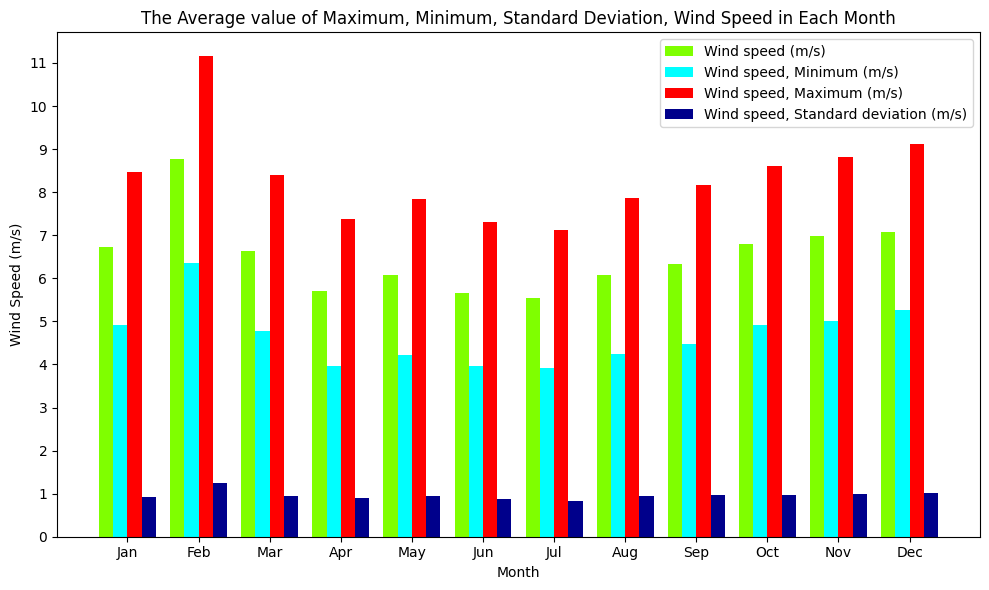

In [24]:
import pandas as pd
import matplotlib.pyplot as plt

# Sample DataFrame (replace this with your actual DataFrame)
data = {
    'Month': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
    'Wind speed (m/s)': [6.723320, 8.776017, 6.632221, 5.707794, 6.067986, 5.669252, 5.553855, 6.084529, 6.341248, 6.793272, 6.975352, 7.066454],
    'Wind speed, Minimum (m/s)': [4.915318, 6.347032, 4.772941, 3.964712, 4.229991, 3.966056, 3.921371, 4.249360, 4.475935, 4.909810, 5.001194, 5.254927],
    'Wind speed, Maximum (m/s)': [8.464820, 11.154339, 8.387874, 7.387647, 7.832869, 7.314732, 7.122394, 7.873816, 8.160654, 8.619364, 8.822612, 9.112006],
    'Wind speed, Standard deviation (m/s)': [0.927291, 1.255139, 0.948231, 0.895795, 0.946820, 0.882598, 0.838781, 0.953920, 0.969114, 0.971919, 1.002223, 1.006174]
}

Wind_SP = pd.DataFrame(data)

# Plotting the grouped bar chart
fig, ax = plt.subplots(figsize=(10, 6))

# Define the width of each bar group
bar_width = 0.2

# Create a list of offsets for each group of bars
bar_offsets = [-1.5 * bar_width, -0.5 * bar_width, 0.5 * bar_width, 1.5 * bar_width]

# List of colors for bars
colors = ['chartreuse', 'cyan', 'red', 'darkblue']

columns_to_plot = ['Wind speed (m/s)', 'Wind speed, Minimum (m/s)', 'Wind speed, Maximum (m/s)', 'Wind speed, Standard deviation (m/s)']

for i, column in enumerate(columns_to_plot):
    ax.bar(Wind_SP['Month'] + bar_offsets[i], Wind_SP[column], width=bar_width, label=column, color=colors[i])

ax.set_xlabel('Month')
ax.set_ylabel('Wind Speed (m/s)')
ax.set_title('The Average value of Maximum, Minimum, Standard Deviation, Wind Speed in Each Month')

# Update the y-axis ticks and labels with 1 m/s difference
y_ticks = range(int(Wind_SP[columns_to_plot].min().min()), int(Wind_SP[columns_to_plot].max().max()) + 1)
ax.set_yticks(y_ticks)


ax.set_xticks(Wind_SP['Month'])
ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
ax.legend()

plt.tight_layout()
plt.show()


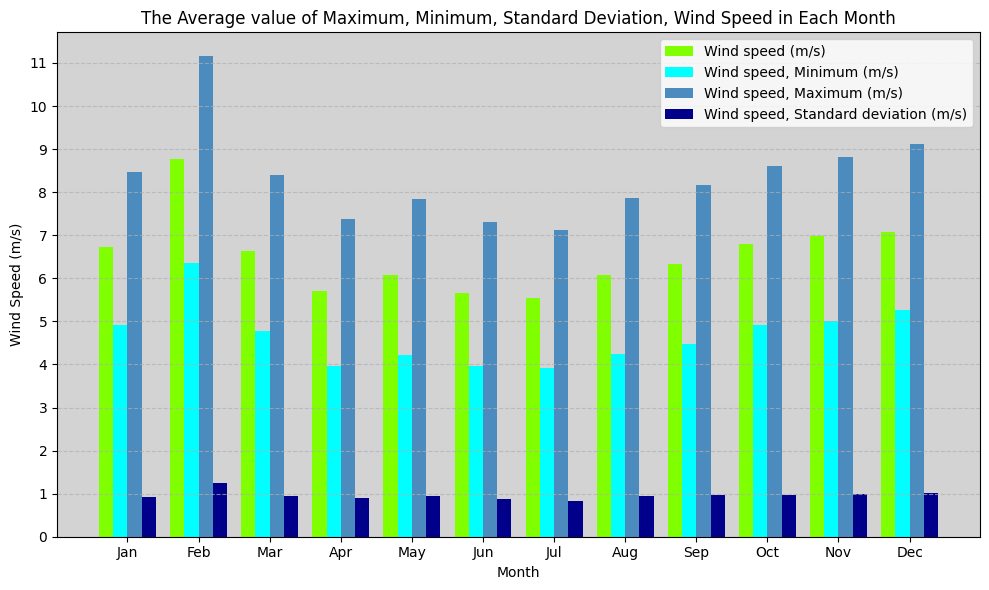

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

# Sample DataFrame (replace this with your actual DataFrame)
data = {
    'Month': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
    'Wind speed (m/s)': [6.723320, 8.776017, 6.632221, 5.707794, 6.067986, 5.669252, 5.553855, 6.084529, 6.341248, 6.793272, 6.975352, 7.066454],
    'Wind speed, Minimum (m/s)': [4.915318, 6.347032, 4.772941, 3.964712, 4.229991, 3.966056, 3.921371, 4.249360, 4.475935, 4.909810, 5.001194, 5.254927],
    'Wind speed, Maximum (m/s)': [8.464820, 11.154339, 8.387874, 7.387647, 7.832869, 7.314732, 7.122394, 7.873816, 8.160654, 8.619364, 8.822612, 9.112006],
    'Wind speed, Standard deviation (m/s)': [0.927291, 1.255139, 0.948231, 0.895795, 0.946820, 0.882598, 0.838781, 0.953920, 0.969114, 0.971919, 1.002223, 1.006174]
}

Wind_SP = pd.DataFrame(data)

# Plotting the grouped bar chart
fig, ax = plt.subplots(figsize=(10, 6))

# Define the width of each bar group
bar_width = 0.2

# Create a list of offsets for each group of bars
bar_offsets = [-1.5 * bar_width, -0.5 * bar_width, 0.5 * bar_width, 1.5 * bar_width]

# List of colors for bars

colors = ['chartreuse', 'cyan', '#4B8BBE', 'darkblue']



columns_to_plot = ['Wind speed (m/s)', 'Wind speed, Minimum (m/s)', 'Wind speed, Maximum (m/s)', 'Wind speed, Standard deviation (m/s)']

for i, column in enumerate(columns_to_plot):
    ax.bar(Wind_SP['Month'] + bar_offsets[i], Wind_SP[column], width=bar_width, label=column, color=colors[i])

ax.set_xlabel('Month')
ax.set_ylabel('Wind Speed (m/s)')
ax.set_title('The Average value of Maximum, Minimum, Standard Deviation, Wind Speed in Each Month')

# Update the y-axis ticks and labels with 1 m/s difference
y_ticks = range(int(Wind_SP[columns_to_plot].min().min()), int(Wind_SP[columns_to_plot].max().max()) + 1)
ax.set_yticks(y_ticks)

# Add grid lines
ax.grid(axis='y', linestyle='--', alpha=0.7)

ax.set_xticks(Wind_SP['Month'])
ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
ax.legend()

# Set background color
ax.set_facecolor('lightgray')

plt.tight_layout()
plt.show()


# Wind Speed Analysing- Wind Speed Plot

In [26]:
#WS=Wind Speed
# Define a New Data Frame to be Faster
WindT_WS= WindT[['Date and time','Wind speed (m/s)']]

In [29]:
wind_speed_data = WindT_WS['Wind speed (m/s)']

# Create a histogram using Plotly Express
fig = px.histogram(
    wind_speed_data,
    nbins=350,
    labels={'value': 'Wind speed (m/s)', 'count': 'Frequency'},
    title='Wind Speed Histogram',
    color_discrete_sequence=['royalblue'],  # Set a color for the bars
)

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Wind speed (m/s)'),
    yaxis=dict(title='Frequency'),
    bargap=0.05,  # Adjust the gap between bars
    xaxis_showgrid=True,  # Show x-axis gridlines
    yaxis_showgrid=True,  # Show y-axis gridlines
    xaxis_gridcolor='lightgray',  # Color of x-axis gridlines
    yaxis_gridcolor='lightgray',  # Color of y-axis gridlines
    barmode='overlay',  # Overlay bars for better visibility
)

# Increase the bar width
fig.update_traces(marker=dict(line=dict(width=2)))

# Show the histogram
fig.show()

In [30]:
#Changing of the Wind Speed over time in a (SPECIFIC DAY)
WindT_WS['Date and time'] = pd.to_datetime(WindT_WS['Date and time'])

# Filter DataFrame for a specific day (e.g., January 1, 2020)
specific_day = '01/01/2020'
filtered_data = WindT_WS[WindT_WS['Date and time'].dt.date == pd.to_datetime(specific_day).date()]

# Create a line plot using px
fig = px.line(
    filtered_data,
    x='Date and time',
    y='Wind speed (m/s)',
    title=f'Wind Speed on {specific_day}',
    labels={'Wind speed (m/s)': 'Wind speed (m/s)'},
    template='plotly_dark',  # Use a dark theme
    line_shape='spline',     # Smooth curves
    render_mode='svg'        # Faster rendering
)
fig.update_xaxes(
    tickformat='%H:%M',
    tickmode='linear',
    tick0=0,
    dtick=60*60*1000,       # 1 hour in milliseconds
    tickangle=45            # Angle of x-axis labels
)
fig.update_layout(xaxis_title='Time', yaxis_title='Wind Speed (m/s)')

# Add nodes (data points) to the plot
fig.add_trace(
    go.Scatter(
        x=filtered_data['Date and time'],
        y=filtered_data['Wind speed (m/s)'],
        mode='markers',
        marker=dict(size=5, color='red'),
        name='Data Points'
    )
)

fig.show()

<ipython-input-30-5f51afd505fc>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [31]:
#Wind Speeds in Two Following Days
#Filtering The DataSet, According to the Dates we Want
start_date = '01/01/2020'
end_date = '01/03/2020'  # Two days 1 and 2 of jan, 2020
filtered_data2 = WindT_WS[
    (WindT_WS['Date and time'] >= start_date) &
    (WindT_WS['Date and time'] <= end_date)]

In [32]:
# Create a line plot using px
fig = px.line(
    filtered_data2,
    x='Date and time',
    y='Wind speed (m/s)',
    title=f'Wind Speed on {specific_day}',
    labels={'Wind speed (m/s)': 'Wind speed (m/s)'},
    template='plotly_dark',  # Use a dark theme
    line_shape='spline',     # Smooth curves
    render_mode='svg'        # Faster rendering
)
fig.update_xaxes(
    tickformat='%H:%M',
    tickmode='linear',
    tick0=0,
    dtick=120*120*1000,       # 2 hour in milliseconds
    tickangle=45            # Angle of x-axis labels
)
fig.update_layout(xaxis_title='Time', yaxis_title='Wind Speed (m/s)')

# Add nodes (data points) to the plot
fig.add_trace(
    go.Scatter(
        x=filtered_data2['Date and time'],
        y=filtered_data2['Wind speed (m/s)'],
        mode='markers',
        marker=dict(size=5, color='red'),
        name='Data Points'
    )
)

fig.show()

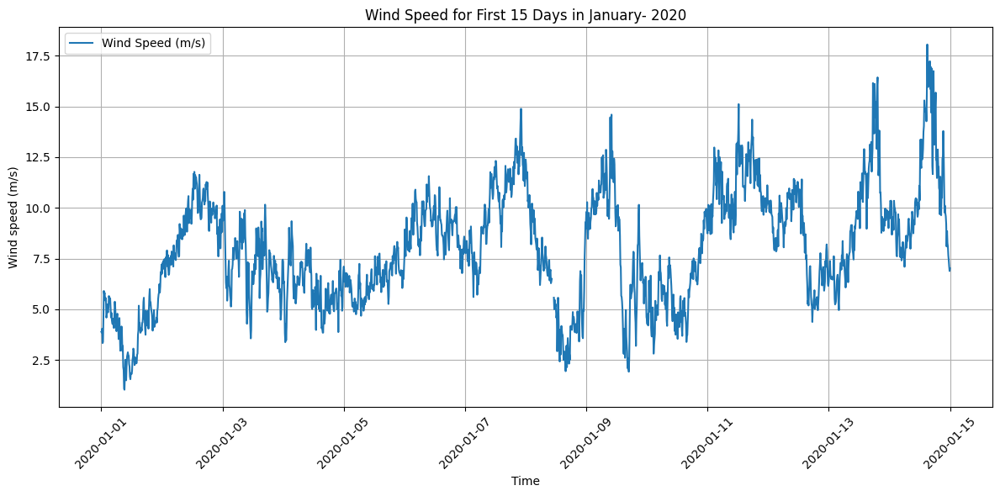

In [33]:

start_date = '01/01/2020'
end_date = '01/15/2020'  # Two days 1 and 2 of jan, 2020
filtered_data3 = WindT_WS[
    (WindT_WS['Date and time'] >= start_date) &
    (WindT_WS['Date and time'] <= end_date)]

# Create a line plot of wind speed over time
plt.figure(figsize=(12, 6))
plt.plot(filtered_data3['Date and time'], filtered_data3['Wind speed (m/s)'], label='Wind Speed (m/s)')
plt.xlabel('Time')
plt.ylabel('Wind speed (m/s)')
plt.title('Wind Speed for First 15 Days in January- 2020')
plt.grid(True)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

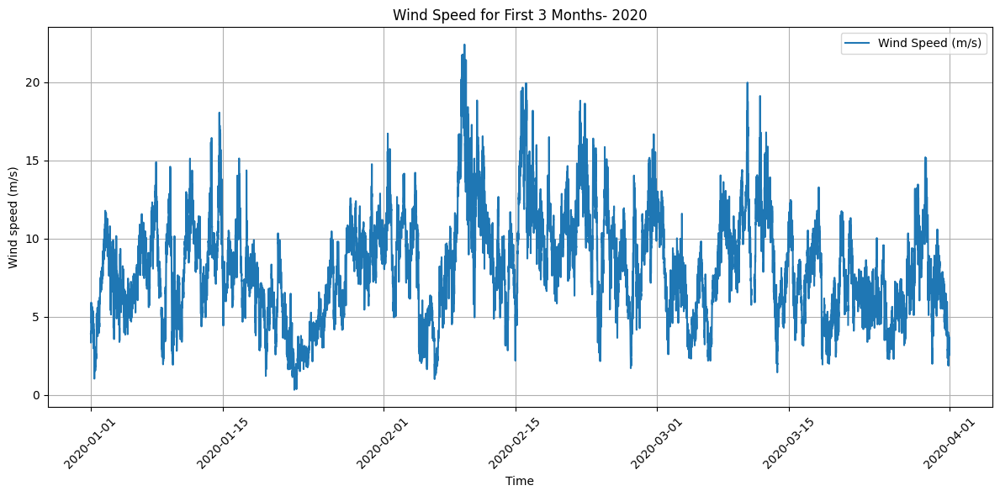

In [34]:
start_date = '01/01/2020'
end_date = '04/01/2020'  # Two days 1 and 2 of jan, 2020
filtered_data3 = WindT_WS[
    (WindT_WS['Date and time'] >= start_date) &
    (WindT_WS['Date and time'] <= end_date)]

# Create a line plot of wind speed over time
plt.figure(figsize=(12, 6))
plt.plot(filtered_data3['Date and time'], filtered_data3['Wind speed (m/s)'], label='Wind Speed (m/s)')
plt.xlabel('Time')
plt.ylabel('Wind speed (m/s)')
plt.title('Wind Speed for First 3 Months- 2020')
plt.grid(True)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

In [35]:
#To Filter the DataFrame According to the Date we Want
#Specific_days = ['01/01/2020', '01/05/2020']
Specific_days = ['2020-01-01', '2020-01-05']

# Filter the DataFrame
# Convert the specific_days list to datetime objects
Specific_dates = pd.to_datetime(Specific_days)
# Use boolean indexing to filter the DataFrame
Filtered_df = WindT_WS[WindT_WS['Date and time'].dt.date.isin(Specific_dates.date)]

In [36]:
# Create a line plot using px
fig = px.line(
    Filtered_df,
    x='Date and time',
    y='Wind speed (m/s)',
    #title=f'Wind Speed on {Specific_days},
    labels={'Wind speed (m/s)': 'Wind speed (m/s)'},
    template='plotly_dark',  # Use a dark theme
    line_shape='spline',     # Smooth curves
    render_mode='svg'        # Faster rendering
)
fig.update_xaxes(
    tickformat='%H:%M',
    tickmode='linear',
    tick0=0,
    dtick=120*120*1000,       # 2 hour in milliseconds
    tickangle=45            # Angle of x-axis labels
)
fig.update_layout(xaxis_title='Time', yaxis_title='Wind Speed (m/s)')


# Add nodes (data points) to the plot
fig.add_trace(
    go.Scatter(
        x=Filtered_df['Date and time'],
        y=Filtered_df['Wind speed (m/s)'],
        mode='markers',
        marker=dict(size=5, color='red'),
        name='Data Points'
    )
)

fig.show()

# Wind Power - Analysing in a Year 2020

In [37]:
WindT_P=WindT[['Wind speed (m/s)','Power (kW)','Potential power default PC (kW)','Potential power learned PC (kW)','Cascading potential power (kW)',
                 'Potential power primary reference turbines (kW)','Turbine Power setpoint (kW)','Turbine Power setpoint (kW)','Potential power estimated (kW)',
                 'Potential power MPC (kW)','Available Capacity for Production (kW)','Production Factor','Available Capacity for Production (Planned) (kW)','Potential power secondary reference turbines (kW)']]

In [40]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual = go.Scatter(
    x=WindT_P['Wind speed (m/s)'],
    y=WindT_P['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=WindT_P['Wind speed (m/s)'],
        colorscale='Jet',
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=WindT_P['Wind speed (m/s)'],
    name='Power vs. Wind Speed'
)

scatter_trace_potential = go.Scatter(
    x=WindT_P['Wind speed (m/s)'],
    y=WindT_P['Potential power MPC (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color='black',
        showscale=False,
        opacity=0.5,
    ),
    text=WindT_P['Wind speed (m/s)'],
    name='Potential Power vs. Wind Speed'
)

# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[WindT_P['Power (kW)'].min(), WindT_P['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[WindT_P['Power (kW)'].min(), WindT_P['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Power (kW)'),
    legend=dict(x=0.1, y=1.1),
    plot_bgcolor='darkgray',
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=WindT_P['Power (kW)'].min(),
            y1=WindT_P['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=WindT_P['Wind speed (m/s)'].max(),
            y0=WindT_P['Power (kW)'].min(),
            y1=WindT_P['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual, scatter_trace_potential, *vertical_lines], layout=layout)

# Set the figure size
fig.update_layout(width=1200, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


In [41]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual = go.Scatter(
    x=WindT_P['Wind speed (m/s)'],
    y=WindT_P['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=WindT_P['Wind speed (m/s)'],
        colorscale='Jet',
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=WindT_P['Wind speed (m/s)'],
    name='Power vs. Wind Speed'
)
#----------------------------------------------------
scatter_trace_potential = go.Scatter(
    x=WindT_P['Wind speed (m/s)'],
    y=WindT_P['Potential power MPC (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color='black',  # Set the color to black
        showscale=False,  # Disable the color scale
        opacity=0.5,  # Set opacity to make points transparent
    ),
    text=WindT_P['Wind speed (m/s)'],
    name='Potential Power vs. Wind Speed'
)


# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[WindT_P['Power (kW)'].min(), WindT_P['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[WindT_P['Power (kW)'].min(), WindT_P['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Power (kW)'),
    legend=dict(x=0.1, y=1.1),
    plot_bgcolor='darkgray',  # Set the darker background color
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=WindT_P['Power (kW)'].min(),
            y1=WindT_P['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=WindT_P['Wind speed (m/s)'].max(),
            y0=WindT_P['Power (kW)'].min(),
            y1=WindT_P['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual, scatter_trace_potential, *vertical_lines], layout=layout)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


In [42]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual = go.Scatter(
    x=WindT_P['Wind speed (m/s)'],
    y=WindT_P['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=WindT_P['Wind speed (m/s)'],
        colorscale='Jet',
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=WindT_P['Wind speed (m/s)'],
    name='Power vs. Wind Speed'
)

scatter_trace_potential = go.Scatter(
    x=WindT_P['Wind speed (m/s)'],
    y=WindT_P['Potential power MPC (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color='black',  # Set the color to black
        showscale=False,  # Disable the color scale
        opacity=0.5,  # Set opacity to make points transparent
    ),
    text=WindT_P['Wind speed (m/s)'],
    name='Potential Power vs. Wind Speed'
)

# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[WindT_P['Power (kW)'].min(), WindT_P['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[WindT_P['Power (kW)'].min(), WindT_P['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color and set figure size
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Power (kW)'),
    legend=dict(x=0.1, y=1.1),
    plot_bgcolor='darkgray',  # Set the darker background color
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=WindT_P['Power (kW)'].min(),
            y1=WindT_P['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=WindT_P['Wind speed (m/s)'].max(),
            y0=WindT_P['Power (kW)'].min(),
            y1=WindT_P['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ],
    width=1500,  # Set the width of the figure
    height=550  # Set the height of the figure
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual, scatter_trace_potential, *vertical_lines], layout=layout)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


# Monthly Power (Speed-RPM) Visualization

In [43]:
Wind_PP=WindT[['Date and time','Wind speed (m/s)','Power (kW)', 'Potential power MPC (kW)']]

In [44]:
Wind_PP['Date and time'] = pd.to_datetime(Wind_PP['Date and time'])
Wind_PP['Month'] = Wind_PP['Date and time'].dt.month

<ipython-input-44-bd3d39b5197e>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-44-bd3d39b5197e>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [45]:
Wind_PP.head(160)

,Date and time,Wind speed (m/s),Power (kW),Potential power MPC (kW),Month
0,2020-01-01 00:00:00,3.887291,150.984141,85.659560,1
1,2020-01-01 00:10:00,3.848941,130.414782,82.821655,1
2,2020-01-01 00:20:00,4.043625,146.401656,98.842346,1
3,2020-01-01 00:30:00,3.330342,84.296224,44.445316,1
4,2020-01-01 00:40:00,3.388536,94.994105,48.751633,1
...,...,...,...,...,...
155,2020-01-02 01:50:00,7.280721,846.182089,738.760678,1
156,2020-01-02 02:00:00,7.903195,1023.857306,946.667289,1
157,2020-01-02 02:10:00,7.107254,730.979913,680.822853,1
158,2020-01-02 02:20:00,7.683193,957.134631,873.186364,1


In [46]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import numpy as np

# Assuming Wind_PP is a pandas DataFrame with the required data

# Create a list of unique months
months = Wind_PP['Month'].unique()[:3]  # Select the first three months

# Initialize a subplot with Plotly Express
fig = make_subplots(rows=1, cols=3, subplot_titles=[f'Month: {month}' for month in months], shared_yaxes=True)

# Plotting for each month separately
for i, month in enumerate(months, 1):
    # Filter data for the specific month
    month_data = Wind_PP[Wind_PP['Month'] == month]

    # Scatter plot for 'Potential power MPC (kW)'
    scatter_potential = px.scatter(month_data, x='Wind speed (m/s)', y='Potential power MPC (kW)', color_discrete_sequence=['black'], labels={'Potential power MPC (kW)': 'Potential power MPC (kW)'})

    # Scatter plot for 'Power (kW)' with transparency and Jet colormap
    scatter_power = px.scatter(month_data, x='Wind speed (m/s)', y='Power (kW)', color=np.arange(len(month_data)), opacity=0.1, color_continuous_scale='jet', labels={'Power (kW)': 'Power (kW)'})

    # Extract traces from Plotly Express objects
    trace_potential = scatter_potential['data'][0]
    trace_power = scatter_power['data'][0]

    # Add traces to subplot
    fig.add_trace(trace_potential, row=1, col=i)
    fig.add_trace(trace_power, row=1, col=i)

# Update layout
fig.update_layout(height=500, width=1200, showlegend=True)
fig.show()


In [47]:
# Assuming Wind_PP is a pandas DataFrame with the required data

# Create a list of unique months
months = Wind_PP['Month'].unique()[0:6]  # Select the first six months

# Convert month numbers to month names
month_names = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
month_names = [month_names[month-1] for month in months]

# Initialize a subplot with Plotly Express
fig = make_subplots(rows=2, cols=3, subplot_titles=[f'Month: {month}' for month in month_names], shared_yaxes=True)

# Plotting for each set of 3 months separately
for i, month in enumerate(months, 1):
    # Calculate the subplot index
    subplot_index = i % 3
    if subplot_index == 0:
        subplot_index = 3

    # Filter data for the specific month
    month_data = Wind_PP[Wind_PP['Month'] == month]

    # Scatter plot for 'Potential power MPC (kW)'
    scatter_potential = px.scatter(month_data, x='Wind speed (m/s)', y='Potential power MPC (kW)', color_discrete_sequence=['black'], labels={'Potential power MPC (kW)': 'Potential power MPC (kW)'})

    # Scatter plot for 'Power (kW)' with a single color (e.g., blue)
    scatter_power = px.scatter(month_data, x='Wind speed (m/s)', y='Power (kW)', opacity=0.1, color_discrete_sequence=['blue'], labels={'Power (kW)': 'Power (kW)'})

    # Extract traces from Plotly Express objects
    trace_potential = scatter_potential['data'][0]
    trace_power = scatter_power['data'][0]

    # Add traces to subplot
    fig.add_trace(trace_potential, row=(i // 4) + 1, col=subplot_index)
    fig.add_trace(trace_power, row=(i // 4) + 1, col=subplot_index)

# Update layout
fig.update_layout(height=800, width=1200, showlegend=True)
fig.show()


In [48]:
Wind_PR=WindT[['Rotor speed (RPM)','Power (kW)','Wind speed (m/s)', 'Date and time']]

In [49]:
Wind_PR['Date and time'] = pd.to_datetime(Wind_PR['Date and time'])
Wind_PR['Month'] = Wind_PR['Date and time'].dt.month

<ipython-input-49-6d424c3eb4de>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-49-6d424c3eb4de>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [50]:
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots

# Assuming Wind_PR is a pandas DataFrame with the required data

# Create a list of unique months
months = sorted(Wind_PR['Month'].unique())[0:6]  # Ensure the months are sorted

# Convert month numbers to month names
month_names = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
month_names = [month_names[month-1] for month in months]

# Initialize a subplot with Plotly Express
fig1 = make_subplots(rows=2, cols=3, subplot_titles=[f'Month: {month}' for month in month_names], shared_yaxes=True)

# Plotting for each set of 3 months separately
for i, month in enumerate(months, 1):
    # Calculate the subplot index
    subplot_index = i % 3
    if subplot_index == 0:
        subplot_index = 3

    # Filter data for the specific month
    month_data = Wind_PR[Wind_PR['Month'] == month]

    # Scatter plot for 'Power (kW)'
    scatter_power = px.scatter(month_data, 'Rotor speed (RPM)', y='Power (kW)', color='Wind speed (m/s)',
                              color_continuous_scale=px.colors.sequential.Sunset, opacity=0.1)

    # Extract traces from Plotly Express objects
    trace_power = scatter_power['data'][0]

    # Add trace to subplot
    fig1.add_trace(trace_power, row=(i - 1) // 3 + 1, col=subplot_index)

    # Update individual subplot layout
    fig1.update_xaxes(title_text="Rotor speed (RPM)", row=(i - 1) // 3 + 1, col=subplot_index)

# Update y-axis label for all subplots
fig1.update_yaxes(title_text="Power (kW)", row=1, col=1)

# Update the overall layout
fig1.update_layout(height=800, width=1200, showlegend=True, coloraxis=dict(colorbar=dict(title='Wind speed (m/s)')))

# Show the figure
fig1.show()


In [51]:
import plotly.express as px

# Assuming WindT is your DataFrame
# If it's not loaded yet, you can load it using something like pd.read_csv('your_data.csv')

# Wind_PR = WindT[['Rotor speed (RPM)', 'Power (kW)', 'Wind speed (m/s)', 'Date and time']]

# Create a scatter plot
fig = px.scatter(
    Wind_PR,
    x='Rotor speed (RPM)',
    y='Power (kW)',
    color='Wind speed (m/s)',  # Use 'Power (kW)' for continuous color
    title='Scatter Plot of Rotor Speed vs Wind Speed with Power as Color',
    labels={'Wind speed (m/s)': 'Wind Speed (m/s)', 'Rotor speed (RPM)': 'Rotor Speed (RPM)'},
    template='plotly_white',  # Use a white template for an academic look
    opacity=0.1,
)

# Adjusting the figure size and styling
fig.update_layout(
    height=600,  # Specify the height of the figure
    width=1000,   # Specify the width of the figure
    plot_bgcolor='rgba(255, 255, 255, 0.9)',  # Set the background color of the plot
    paper_bgcolor='rgba(255, 255, 255, 0.9)',  # Set the background color of the paper
    xaxis=dict(showgrid=True, gridcolor='rgba(0, 0, 0, 0.1)', gridwidth=2),  # Show x-axis grid lines with a grid width of 2
    yaxis=dict(showgrid=True, gridcolor='rgba(0, 0, 0, 0.1)', gridwidth=2),  # Show y-axis grid lines with a grid width of 2
)

# Add grid lines
fig.update_layout(
    xaxis=dict(showgrid=True, gridwidth=0.5, gridcolor='lightgray', linecolor='black', linewidth=2, zeroline=False, tickfont=dict(size=14)),  # Adjust tickfont size
    yaxis=dict(showgrid=True, gridwidth=0.5, gridcolor='lightgray', linecolor='black', linewidth=2, zeroline=False, tickfont=dict(size=14)),  # Adjust tickfont size
)

# Make axis bolder
fig.update_xaxes(showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(showline=True, linewidth=2, linecolor='black')


fig.show()


In [52]:
import plotly.express as px

# Assuming WindT is your DataFrame
# If it's not loaded yet, you can load it using something like pd.read_csv('your_data.csv')

# Wind_PR = WindT[['Rotor speed (RPM)', 'Power (kW)', 'Wind speed (m/s)', 'Date and time']]

# Create a scatter plot
fig = px.scatter(
    Wind_PR,
    x='Wind speed (m/s)',
    y='Rotor speed (RPM)',
    color='Power (kW)',  # Use 'Power (kW)' for continuous color
    title='Scatter Plot of Rotor Speed vs Wind Speed with Power as Color',
    labels={'Wind speed (m/s)': 'Wind Speed (m/s)', 'Rotor speed (RPM)': 'Rotor Speed (RPM)'},
    template='plotly_white',  # Use a white template for an academic look
    opacity=0.1,
)

# Adjusting the figure size and styling
fig.update_layout(
    height=600,  # Specify the height of the figure
    width=1000,   # Specify the width of the figure
    plot_bgcolor='rgba(255, 255, 255, 0.9)',  # Set the background color of the plot
    paper_bgcolor='rgba(255, 255, 255, 0.9)',  # Set the background color of the paper
    xaxis=dict(showgrid=True, gridcolor='rgba(0, 0, 0, 0.1)', gridwidth=2),  # Show x-axis grid lines with a grid width of 2
    yaxis=dict(showgrid=True, gridcolor='rgba(0, 0, 0, 0.1)', gridwidth=2),  # Show y-axis grid lines with a grid width of 2
)

# Add grid lines
fig.update_layout(
    xaxis=dict(showgrid=True, gridwidth=0.5, gridcolor='lightgray', linecolor='black', linewidth=2, zeroline=False, tickfont=dict(size=14)),  # Adjust tickfont size
    yaxis=dict(showgrid=True, gridwidth=0.5, gridcolor='lightgray', linecolor='black', linewidth=2, zeroline=False, tickfont=dict(size=14)),  # Adjust tickfont size
)

# Make axis bolder
fig.update_xaxes(showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(showline=True, linewidth=2, linecolor='black')


fig.show()



# Pitch Control Analysis

In [53]:
# PC = Pitch Control
Wind_PC=WindT[['Date and time','Wind speed (m/s)','Power (kW)','Rotor speed (RPM)','Blade angle (pitch position) A (°)','Blade angle (pitch position) B (°)','Blade angle (pitch position) C (°)']]

In [54]:
import plotly.express as px

# Assuming Wind_PC is your DataFrame

# Plotting Blade angle (pitch position) A (°) against Power (kW) with Wind speed as color
fig = px.scatter(Wind_PC, x='Blade angle (pitch position) B (°)', y='Power (kW)',
                 color='Wind speed (m/s)',
                 opacity=0.1,
                 title='Blade angle A vs Power with Wind speed',
                 labels={'Wind speed (m/s)': 'Wind speed (m/s)', 'Blade angle (pitch position) A (°)': 'Blade angle A (°)', 'Power (kW)': 'Power (kW)'})

fig.update_layout(showlegend=True)
fig.show()


In [56]:
import plotly.express as px

# Assuming Wind_PC is your DataFrame

# Plotting Blade angle (pitch position) A (°) against Power (kW) with Wind speed as color
fig = px.scatter(Wind_PC, x='Wind speed (m/s)', y='Blade angle (pitch position) B (°)',
                 color='Power (kW)',
                 opacity=0.5,
                 title='Blade Pitch angle B vs Wind Speed',
                 labels={'Power (kW)': 'Power (kW)', 'Blade angle (pitch position) B (°)': 'Blade angle B (°)'})

fig.update_layout(
    showlegend=True,
    height=600,  # Set the height of the figure
    width=1000,   # Set the width of the figure
    yaxis=dict(range=[0, 50], dtick=5),
    xaxis=dict(range=[0, 26], dtick=2)# Set the Y-axis range and tick interval
)

# Add red dashed line at rated speed
fig.add_shape(
    dict(
        type='line',
        x0=12.5,
        x1=12.5,
        y0=0,
        y1=15,
        line=dict(color='red', width=2, dash='dash')
    )
)

# Add label for the red dashed line
fig.update_layout(
    annotations=[
        dict(
            x=12.5,
            y=8,  # Adjust the y-coordinate for label placement
            xref="x",
            yref="y",
            text="Rated Speed = 12.5",
            showarrow=True,
            arrowhead=2,
            ax=0,
            ay=-40  # Adjust the arrowhead position
        )
    ]
)

#####

# Adjusting the figure size and styling
fig.update_layout(
    height=700,  # Specify the height of the figure
    width=1100,   # Specify the width of the figure
    plot_bgcolor='rgba(255, 255, 255, 0.9)',  # Set the background color of the plot
    paper_bgcolor='rgba(255, 255, 255, 0.9)',  # Set the background color of the paper
    xaxis=dict(showgrid=True, gridcolor='rgba(0, 0, 0, 0.1)', gridwidth=2),  # Show x-axis grid lines with a grid width of 2
    yaxis=dict(showgrid=True, gridcolor='rgba(0, 0, 0, 0.1)', gridwidth=2),  # Show y-axis grid lines with a grid width of 2
)

# Add grid lines
fig.update_layout(
    xaxis=dict(showgrid=True, gridwidth=0.5, gridcolor='lightgray', linecolor='black', linewidth=2, zeroline=False, tickfont=dict(size=14)),  # Adjust tickfont size
    yaxis=dict(showgrid=True, gridwidth=0.5, gridcolor='lightgray', linecolor='black', linewidth=2, zeroline=False, tickfont=dict(size=14)),  # Adjust tickfont size
)

# Make axis bolder
fig.update_xaxes(showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(showline=True, linewidth=2, linecolor='black')

fig.show()


# Data Cleanig
### Outlier Detection

In [57]:
# 52704 Rows In a General Data Frame
#At Firs Specify a Data Set with It's Columns
#DC=Data Cleaning
Wind_DC=WindT[['Date and time','Wind speed (m/s)','Wind direction (°)','Nacelle position (°)','Power (kW)', 'Potential power MPC (kW)' , 'Power factor (cosphi)'
              ,'Ambient temperature (converter) (°C)','Rotor speed (RPM)','Gearbox speed (RPM)','Blade angle (pitch position) A (°)','Month']]

In [58]:
Wind_DC

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
52699,2020-12-31 23:10:00,5.119444,303.499764,313.365387,-3.748371,227.216542,1.000000,1.8775,0.000000,0.009000,89.989998,12
52700,2020-12-31 23:20:00,5.009681,304.460909,313.365387,-2.761930,206.800739,1.000000,1.8550,0.000000,0.000000,89.989998,12
52701,2020-12-31 23:30:00,5.060813,300.909886,313.365387,-2.240700,216.311142,1.000000,1.8575,0.000000,0.051603,89.989998,12
52702,2020-12-31 23:40:00,4.814269,297.398429,313.365387,-4.011920,184.383845,1.000000,1.8500,0.000000,0.000000,89.989998,12


In [59]:
# For Outlier Detection

import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual = go.Scatter(
    x=Wind_DC['Wind speed (m/s)'],
    y=Wind_DC['Blade angle (pitch position) A (°)'],
    mode='markers',
    marker=dict(
        size=3,
        color=Wind_DC['Power (kW)'],
        colorscale='Jet',
        showscale=True,
        opacity=0.3,
        colorbar=dict(title='Power (kW)')
    ),
    text=Wind_DC['Power (kW)'],  # Use 'Power (kW)' for hover text
    name='Blade angle (pitch position) vs. Wind Speed'
)

# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[Wind_DC['Blade angle (pitch position) A (°)'].min(), Wind_DC['Blade angle (pitch position) A (°)'].max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[Wind_DC['Blade angle (pitch position) A (°)'].min(),Wind_DC['Blade angle (pitch position) A (°)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Blade angle (pitch position) A (°)'),
    legend=dict(x=0.7, y=1.2),
    plot_bgcolor='darkgray',
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=Wind_DC['Blade angle (pitch position) A (°)'].min(),
            y1=Wind_DC['Blade angle (pitch position) A (°)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=Wind_DC['Wind speed (m/s)'].max(),
            y0=Wind_DC['Blade angle (pitch position) A (°)'].min(),
            y1=Wind_DC['Blade angle (pitch position) A (°)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual, *vertical_lines], layout=layout)

# Set the figure size
fig.update_layout(width=1000, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


In [60]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual1 = go.Scatter(
    x=Wind_DC['Rotor speed (RPM)'],
    y=Wind_DC['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=Wind_DC['Wind speed (m/s)'],
        colorscale='Jet',
        opacity=0.3,
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=Wind_DC['Wind speed (m/s)'],  # Use 'Power (kW)' for hover text
    name='Rotate Per Minute (RPM) vs. Power'
)

# Create a layout for the figure with axis labels
layout = go.Layout(
    title='Power vs. Rotor Speed',
    xaxis=dict(title='Rotor Speed (RPM)'),  # Add x-axis label
    yaxis=dict(title='Power (kW)'),  # Add y-axis label
    #xaxis=dict(title='Rotor Speed (RPM)', titlefont=dict(size=20, color='black')),  # Bold and dark x-axis title
    #yaxis=dict(title='Power (kW)', titlefont=dict(size=20, color='black')),  # Bold and dark y-axis title
    plot_bgcolor='lightgray'

)

# Create a figure and add the scatter plot trace and layout
fig = go.Figure(data=[scatter_trace_actual1], layout=layout)

# Set the figure size
fig.update_layout(width=1000, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()

## Data Cleaning - Nan Value
- Remove Nan-Values


In [61]:
# 1 - Remove Non Values


# 722 Nun Values In all 12 Months

# The Number of Nun Values For Each Column and MONTH
# Create a DataFrame with null values as True and non-null values as False
null_mask = Wind_DC.isnull()

# Group the data by month and sum the True values (True is equivalent to 1)
null_counts = null_mask.groupby(Wind_DC['Month']).sum()

null_counts


,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
Month,,,,,,,,,,,,
1,0,5,5,5,5,5,5,5,5,5,5,0
2,0,0,0,0,0,0,0,0,0,0,0,0
3,0,70,70,70,70,70,70,70,70,70,70,0
4,0,15,15,15,15,15,15,15,15,15,15,0
5,0,70,70,70,70,70,70,70,70,70,70,0
6,0,131,131,131,131,131,131,131,131,131,131,0
7,0,59,59,59,59,59,59,59,59,59,59,0
8,0,41,41,41,41,41,41,41,41,41,41,0
9,0,68,68,68,68,68,68,68,68,68,68,0


### Writing Function to find Nun Values for Each Months - Monthly Time-Wind -( Removing Outliers )- Speed Drawing

In [62]:
#Monthly Data Null Values
def Monthly_Null_Values(data_frame, Month):
    # Filter the DataFrame to select rows where 'month' matches the input value
    Monthly_Data = data_frame[data_frame['Month'] == Month]

    # Identify and display rows with null values in the filtered data
    Monthly_Null_Values =  Monthly_Data[ Monthly_Data.isnull().any(axis=1)]

    return Monthly_Null_Values


In [63]:
Monthly_Null_Values(Wind_DC, 1)

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
1011,2020-01-08 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1071,2020-01-08 10:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1072,2020-01-08 10:40:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1073,2020-01-08 10:50:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1074,2020-01-08 11:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1


In [64]:
# Extract Data Related to the Month 6

# To Extract the Data related to the Month 6
Monthly_Data_6 = Wind_DC[Wind_DC['Month'] == 6]
Monthly_Data_6

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
21888,2020-06-01 00:00:00,4.280519,67.944133,56.536777,167.070759,125.137644,-0.833044,15.747500,8.623753,1027.258266,0.0000,6
21889,2020-06-01 00:10:00,3.298099,67.593529,56.536777,87.716182,42.059330,-0.615962,15.457500,8.156889,972.673233,0.3515,6
21890,2020-06-01 00:20:00,3.383431,61.253243,56.536777,103.695380,48.373879,-0.755575,15.350000,8.150827,971.009754,0.1630,6
21891,2020-06-01 00:30:00,4.604175,54.758672,56.536777,173.635346,161.063435,-0.898636,15.197500,8.653311,1030.000820,0.0000,6
21892,2020-06-01 00:40:00,4.330452,56.048306,56.536777,169.210735,130.680216,-0.900254,15.062500,8.590746,1024.143963,0.0000,6
...,...,...,...,...,...,...,...,...,...,...,...,...
26203,2020-06-30 23:10:00,4.470210,210.958763,209.097260,179.311019,146.193260,-0.893006,18.047500,8.734909,1040.597322,0.0000,6
26204,2020-06-30 23:20:00,4.882450,215.792903,209.097260,210.279492,191.951897,-0.883144,17.965789,9.096015,1079.744478,0.0000,6
26205,2020-06-30 23:30:00,5.590456,217.216560,209.097260,321.504546,314.824880,-0.901517,17.842500,10.234672,1215.228224,0.0000,6
26206,2020-06-30 23:40:00,5.031911,219.593789,209.097260,273.330340,210.935416,-0.883241,17.765000,9.777113,1162.384752,0.0000,6


In [65]:
#Nun Values are Removed

# First Step is Done and Nan Value are removed from the dataset

#To clean the Nun Values From the Data Set
Wind_DC = Wind_DC.dropna()
Wind_DC

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
52699,2020-12-31 23:10:00,5.119444,303.499764,313.365387,-3.748371,227.216542,1.000000,1.8775,0.000000,0.009000,89.989998,12
52700,2020-12-31 23:20:00,5.009681,304.460909,313.365387,-2.761930,206.800739,1.000000,1.8550,0.000000,0.000000,89.989998,12
52701,2020-12-31 23:30:00,5.060813,300.909886,313.365387,-2.240700,216.311142,1.000000,1.8575,0.000000,0.051603,89.989998,12
52702,2020-12-31 23:40:00,4.814269,297.398429,313.365387,-4.011920,184.383845,1.000000,1.8500,0.000000,0.000000,89.989998,12


In [66]:
# Check THE results whether the DataSet Contains any Nun Values or not After deleting the Nun Values

# The results show that the Null Values
Monthly_Null_Values(Wind_DC, 8)

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month


### Remained Data after Cleaning and Removing the outliers

- Total : 52703
- Removing Nun Values : 51982
- Removing Negative Power: 46698
- Removing Blade Angle greater than 25 : 46452
- Removing Blade Angle greater than 1.8 lower than 5 : 45778

## Data Cleaning Considering Other Features - Wind_DC DataSet is cleared.
- Power
- Blade Angle
- Wind and Blade Angle

In [67]:
# After Removing the Nun Values
#2- Remove Negative Power
Wind_DC = Wind_DC[Wind_DC['Power (kW)'] >= 0]
Wind_DC

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
52584,2020-12-31 04:00:00,5.178239,297.682228,302.389740,253.194262,238.152452,-0.923439,1.9725,9.364814,1115.398745,0.000000,12
52585,2020-12-31 04:10:00,4.821635,305.060363,302.389740,163.248461,185.201469,-0.879924,1.9375,8.412000,1001.514748,0.000000,12
52586,2020-12-31 04:20:00,3.721027,294.466126,302.389740,71.799255,73.355997,-0.619152,1.8800,8.144028,970.660664,0.667000,12
52587,2020-12-31 04:30:00,3.317824,283.868423,296.654098,4.874413,43.518994,0.377544,1.7625,5.057464,604.132449,19.404501,12


In [68]:
#3- Remove the Pitch Blade Position
Wind_DC = Wind_DC[Wind_DC['Blade angle (pitch position) A (°)'] <= 25]
Wind_DC

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
52583,2020-12-31 03:50:00,5.253287,296.687748,302.389740,259.256242,252.111432,-0.939509,2.0300,9.432259,1124.090298,0.000000,12
52584,2020-12-31 04:00:00,5.178239,297.682228,302.389740,253.194262,238.152452,-0.923439,1.9725,9.364814,1115.398745,0.000000,12
52585,2020-12-31 04:10:00,4.821635,305.060363,302.389740,163.248461,185.201469,-0.879924,1.9375,8.412000,1001.514748,0.000000,12
52586,2020-12-31 04:20:00,3.721027,294.466126,302.389740,71.799255,73.355997,-0.619152,1.8800,8.144028,970.660664,0.667000,12


In [70]:
# I want to Remove the outliers by applying Filter for Wind Speed lower than 7.5 and Blade angle greater than 1.5- Because The Blade Angles Greater than these amounts Will Be used For Stsrting the Rotation
filtered_data = Wind_DC[(Wind_DC['Blade angle (pitch position) A (°)'] >= 1.8) & (Wind_DC['Wind speed (m/s)'] <= 5)]

# Remove the filtered rows from the original dataset
Wind_DC = Wind_DC.drop(filtered_data.index)
Wind_DC

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
52582,2020-12-31 03:40:00,4.907356,294.267196,302.389740,192.072098,194.716566,-0.906362,1.9375,8.711837,1037.487917,0.000000,12
52583,2020-12-31 03:50:00,5.253287,296.687748,302.389740,259.256242,252.111432,-0.939509,2.0300,9.432259,1124.090298,0.000000,12
52584,2020-12-31 04:00:00,5.178239,297.682228,302.389740,253.194262,238.152452,-0.923439,1.9725,9.364814,1115.398745,0.000000,12
52585,2020-12-31 04:10:00,4.821635,305.060363,302.389740,163.248461,185.201469,-0.879924,1.9375,8.412000,1001.514748,0.000000,12


## After Cleaning- Identify the outliers and Remove them Considering the Box Plot - Histogram


In [72]:
# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual = go.Scatter(
    x=Wind_DC['Wind speed (m/s)'],
    y=Wind_DC['Blade angle (pitch position) A (°)'],
    mode='markers',
    marker=dict(
        size=3,
        color=Wind_DC['Power (kW)'],
        colorscale='Jet',
        showscale=True,
        opacity=0.3,
        colorbar=dict(title='Power (kW)')
    ),
    text=Wind_DC['Power (kW)'],  # Use 'Power (kW)' for hover text
    name='Blade angle (pitch position) vs. Wind Speed'
)

# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[Wind_DC['Blade angle (pitch position) A (°)'].min(), Wind_DC['Blade angle (pitch position) A (°)'].max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[Wind_DC['Blade angle (pitch position) A (°)'].min(),Wind_DC['Blade angle (pitch position) A (°)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Blade angle (pitch position) A (°)'),
    legend=dict(x=0.7, y=1.2),
    plot_bgcolor='darkgray',
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=Wind_DC['Blade angle (pitch position) A (°)'].min(),
            y1=Wind_DC['Blade angle (pitch position) A (°)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=Wind_DC['Wind speed (m/s)'].max(),
            y0=Wind_DC['Blade angle (pitch position) A (°)'].min(),
            y1=Wind_DC['Blade angle (pitch position) A (°)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual, *vertical_lines], layout=layout)

# Set the figure size
fig.update_layout(width=1000, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()

In [73]:
Wind_DC

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1
...,...,...,...,...,...,...,...,...,...,...,...,...
52582,2020-12-31 03:40:00,4.907356,294.267196,302.389740,192.072098,194.716566,-0.906362,1.9375,8.711837,1037.487917,0.000000,12
52583,2020-12-31 03:50:00,5.253287,296.687748,302.389740,259.256242,252.111432,-0.939509,2.0300,9.432259,1124.090298,0.000000,12
52584,2020-12-31 04:00:00,5.178239,297.682228,302.389740,253.194262,238.152452,-0.923439,1.9725,9.364814,1115.398745,0.000000,12
52585,2020-12-31 04:10:00,4.821635,305.060363,302.389740,163.248461,185.201469,-0.879924,1.9375,8.412000,1001.514748,0.000000,12


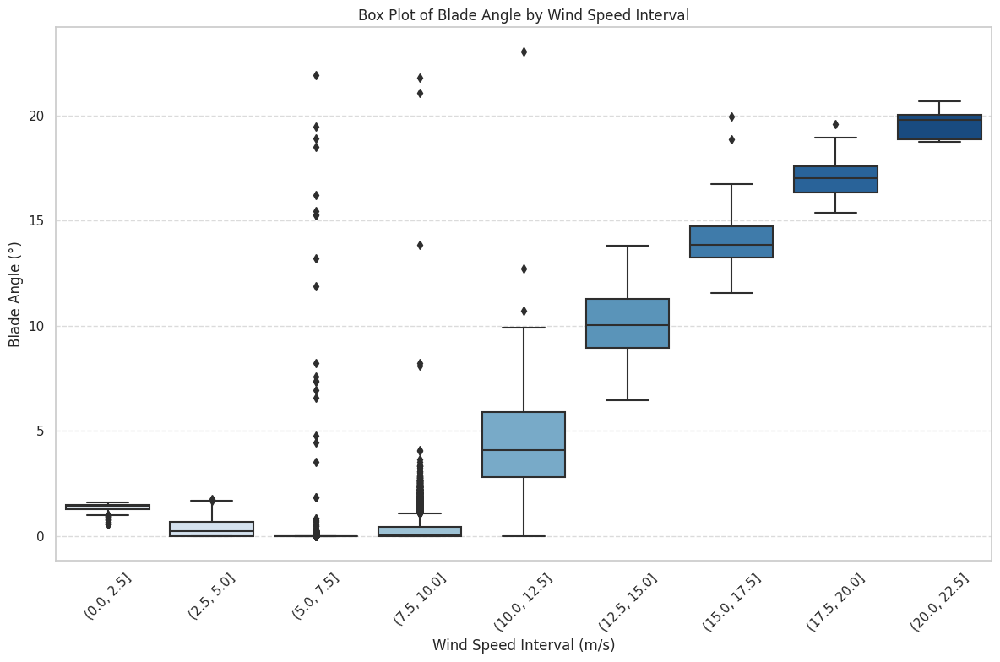

In [75]:
#BoxPlot and Blade Pitch Angle and Outlier Detection
#Blade Pitch Angle Box Plot


import seaborn as sns
import matplotlib.pyplot as plt

# Define the figure size
plt.figure(figsize=(12, 8))

# Set Seaborn style
sns.set(style="whitegrid")

# Define wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create a new column in the DataFrame to categorize wind speed into intervals
Wind_DC['Wind Speed Interval'] = pd.cut(Wind_DC['Wind speed (m/s)'], bins=wind_speed_intervals)

# Customize the color palette
custom_palette = sns.color_palette("Blues", n_colors=9)  # You can adjust the color palette as needed

# Create the box plot
ax = sns.boxplot(data=Wind_DC, x="Wind Speed Interval", y="Blade angle (pitch position) A (°)", palette=custom_palette)

# Set title, labels, and rotation
ax.set_title("Box Plot of Blade Angle by Wind Speed Interval")
ax.set_ylabel('Blade Angle (°)')
ax.set_xlabel("Wind Speed Interval (m/s)")
plt.xticks(rotation=45)

# Add grid lines for better readability
ax.yaxis.grid(True, linestyle='--', alpha=0.7)

# If you want to add data points (swarm plot) for each observation, you can uncomment and customize this line
# sns.swarmplot(data=Wind_DC, x="Wind Speed Interval", y="Blade angle (pitch position) A (°)", color="0.2")

# Adjust the plot layout for better spacing
plt.tight_layout()

# If you want to save the plot to a file, uncomment and specify the desired filename
# plt.savefig("boxplot.png", dpi=300)

# Show the plot
plt.show()


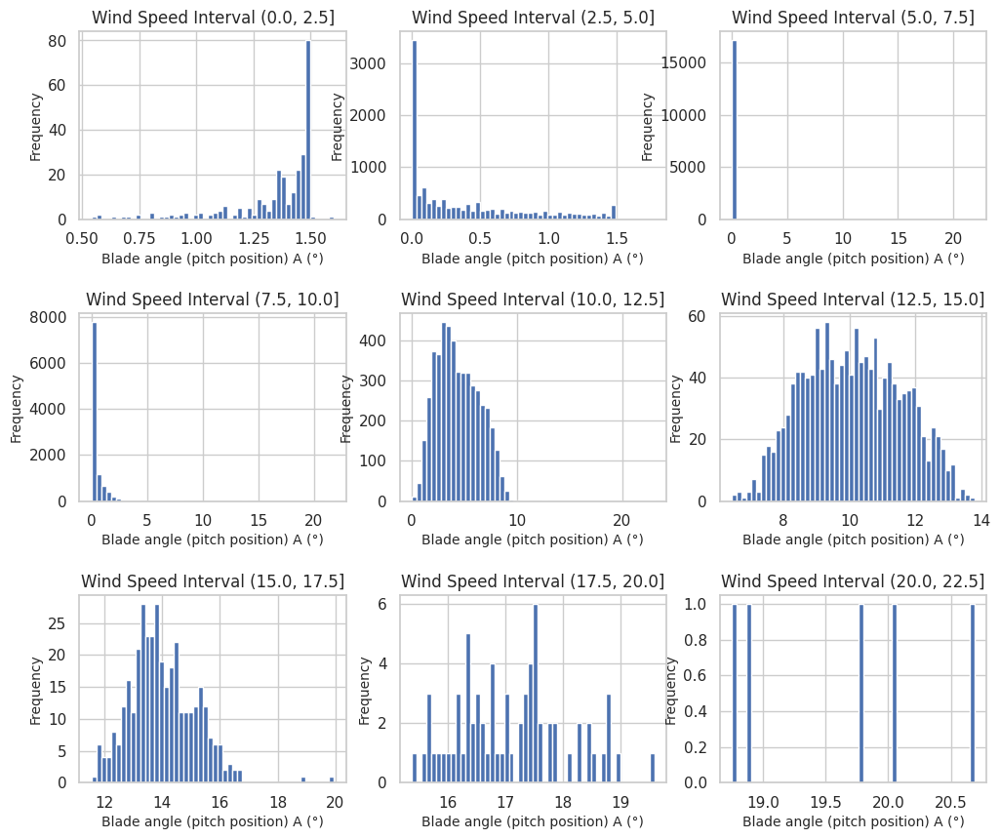

In [76]:
#Box Plot - Frequency - Blade Pitch - Wind Speed


import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named Wind_DC with the relevant data

# Define wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create a new column in Wind_DC to categorize the data into wind speed intervals
Wind_DC['Wind Speed Interval'] = pd.cut(Wind_DC['Wind speed (m/s)'], wind_speed_intervals)

# Initialize a counter to keep track of figures in each row
figure_counter = 0

# Create a subplot with 3 figures per row
fig, axes = plt.subplots(3, 3, figsize=(12, 10))
fig.subplots_adjust(hspace=0.5)

for interval, group in Wind_DC.groupby('Wind Speed Interval'):
    if figure_counter >= 9:
        # Start a new row when reaching the 4th figure in a row
        figure_counter = 0
        fig, axes = plt.subplots(3, 3, figsize=(12, 10))
        fig.subplots_adjust(hspace=0.5)

    ax = axes[figure_counter // 3, figure_counter % 3]
    ax.hist(group['Blade angle (pitch position) A (°)'], bins=50)  # You can adjust the number of bins as needed
    ax.set_title(f'Wind Speed Interval {interval}')
    ax.set_xlabel('Blade angle (pitch position) A (°)', fontsize=10)
    ax.set_ylabel('Frequency', fontsize=10)

    figure_counter += 1

# Ensure that all subplots are utilized even if there are fewer than 9 intervals
for i in range(figure_counter, 9):
    fig.delaxes(axes[i // 3, i % 3])

plt.show()


In [ ]:

# Remove of All outlier in the Box Plot - Pitch Angle
# This Will BE NOT used for the purpose of Data Cleaning Because all of the Histograms do not Show the Normal Distribution
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define the wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create an empty DataFrame to store the data
Wind_DC_OutlierRemove_BladePitch = pd.DataFrame()

# Create an empty list to store the labels for wind speed intervals
# interval_labels = []

# Specify the wind speed interval you want to skip (e.g., wind_speed_to_skip)


# Iterate through the wind speed intervals
for i in range(len(wind_speed_intervals) - 1):
    lower_bound = wind_speed_intervals[i]
    upper_bound = wind_speed_intervals[i + 1]

    # Skip the specified wind speed interval


    # Filter data within the current wind speed interval
    subset = Wind_DC[(Wind_DC["Wind speed (m/s)"] >= lower_bound) & (Wind_DC["Wind speed (m/s)"] <= upper_bound)]

    # Calculate the IQR for the current interval
    Q1 = subset['Blade angle (pitch position) A (°)'].quantile(0.25)
    Q3 = subset['Blade angle (pitch position) A (°)'].quantile(0.75)
    IQR = Q3 - Q1

    # Define the lower and upper bounds for outliers
    lower_bound_Power = Q1 - 1.5 * IQR
    upper_bound_Power = Q3 + 1.5 * IQR

    # Filter and append the data to the Wind_DC1_OutlierRemove DataFrame
    subset2 = subset[(subset['Blade angle (pitch position) A (°)'] >= lower_bound_Power) & (subset['Blade angle (pitch position) A (°)'] <= upper_bound_Power)]
    Wind_DC_OutlierRemove_BladePitch = pd.concat([Wind_DC_OutlierRemove_BladePitch, subset2])

In [77]:
## Update Above Code for Considering Only [(10, 12.5), (12.5, 15), (15, 17.5)]to Remove
## This Will BE applied in order to Remove the outlier from wind Speed Intervals showing the Normal Distribution
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define the wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create an empty DataFrame to store the data
Wind_DC_OutlierRemove_BladePitch = pd.DataFrame()

# Specify the wind speed intervals to remove outliers from
wind_speed_intervals_to_remove_outliers = [(10, 12.5), (12.5, 15), (15, 17.5)]

# Iterate through the wind speed intervals
for i in range(len(wind_speed_intervals) - 1):
    lower_bound = wind_speed_intervals[i]
    upper_bound = wind_speed_intervals[i + 1]

    # Check if the current interval is in the list of intervals to remove outliers from
    if (lower_bound, upper_bound) in wind_speed_intervals_to_remove_outliers:
        # Filter data within the current wind speed interval
        subset = Wind_DC[(Wind_DC["Wind speed (m/s)"] >= lower_bound) & (Wind_DC["Wind speed (m/s)"] <= upper_bound)]

        # Calculate the IQR for the current interval
        Q1 = subset['Blade angle (pitch position) A (°)'].quantile(0.25)
        Q3 = subset['Blade angle (pitch position) A (°)'].quantile(0.75)
        IQR = Q3 - Q1

        # Define the lower and upper bounds for outliers
        lower_bound_BladePitch = Q1 - 1.5 * IQR
        upper_bound_BladePitch = Q3 + 1.5 * IQR

        # Filter and append the data to the Wind_DC_OutlierRemove_BladePitch DataFrame
        subset2 = subset[(subset['Blade angle (pitch position) A (°)'] >= lower_bound_BladePitch) & (subset['Blade angle (pitch position) A (°)'] <= upper_bound_BladePitch)]
        Wind_DC_OutlierRemove_BladePitch = pd.concat([Wind_DC_OutlierRemove_BladePitch, subset2])
    else:
        # If not in the list, include the data without removing outliers
        Wind_DC_OutlierRemove_BladePitch = pd.concat([Wind_DC_OutlierRemove_BladePitch, Wind_DC[(Wind_DC["Wind speed (m/s)"] >= lower_bound) & (Wind_DC["Wind speed (m/s)"] <= upper_bound)]])





In [78]:
Wind_DC_OutlierRemove_BladePitch

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
1089,2020-01-08 13:30:00,2.423712,290.079739,273.854096,6.923044,0.0,-0.537898,14.240000,8.150848,970.152145,1.415002,1,"(0.0, 2.5]"
1098,2020-01-08 15:00:00,2.494213,288.816348,273.854096,1.680593,0.0,-0.433042,13.417500,8.142291,969.860281,1.490000,1,"(0.0, 2.5]"
3010,2020-01-21 21:40:00,2.174622,323.115876,310.073731,11.170479,0.0,-0.226233,8.240000,8.143679,970.612621,1.365001,1,"(0.0, 2.5]"
3043,2020-01-22 03:10:00,2.313614,317.192963,311.171295,40.598040,0.0,-0.382174,8.439474,8.285479,986.492061,1.095264,1,"(0.0, 2.5]"
3072,2020-01-22 08:00:00,2.457181,325.376335,301.293213,22.807273,0.0,-0.296523,8.300000,8.143504,970.376822,1.190506,1,"(0.0, 2.5]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5655,2020-02-09 06:30:00,20.182289,214.095686,213.488037,2058.689313,2050.0,-0.963857,13.065000,15.201329,1807.071957,18.881710,2,"(20.0, 22.5]"
5668,2020-02-09 08:40:00,20.205789,213.901162,213.488037,2034.674988,2050.0,-0.958202,13.175000,15.170782,1803.760002,20.032981,2,"(20.0, 22.5]"
5697,2020-02-09 13:30:00,21.831159,221.794024,213.488037,2033.658093,2050.0,-0.961450,13.482500,15.241400,1807.290533,20.689644,2,"(20.0, 22.5]"
5698,2020-02-09 13:40:00,20.418627,224.424992,213.488037,2008.372278,2050.0,-0.961687,13.620000,15.108765,1796.103916,18.750936,2,"(20.0, 22.5]"


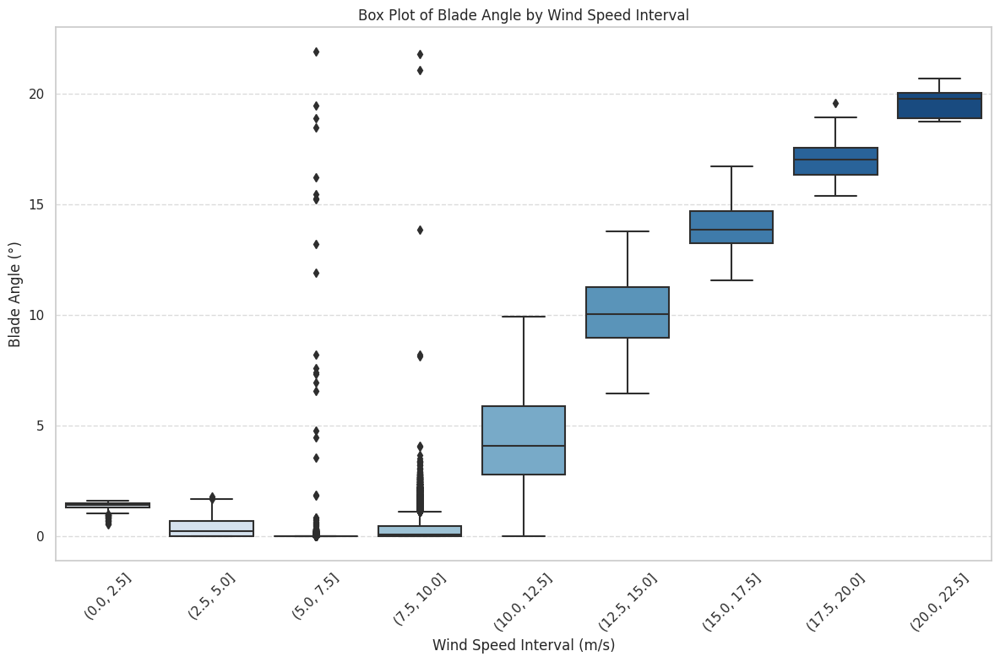

In [79]:
# The Box Plot after Removing Outliers in Wind Speed Intervals Showing the Normal Distribution
import seaborn as sns
import matplotlib.pyplot as plt

# Define the figure size
plt.figure(figsize=(12, 8))

# Set Seaborn style
sns.set(style="whitegrid")

# Define wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create a new column in the DataFrame to categorize wind speed into intervals
Wind_DC_OutlierRemove_BladePitch['Wind Speed Interval'] = pd.cut(Wind_DC_OutlierRemove_BladePitch['Wind speed (m/s)'], bins=wind_speed_intervals)

# Customize the color palette
custom_palette = sns.color_palette("Blues", n_colors=9)  # You can adjust the color palette as needed

# Create the box plot
ax = sns.boxplot(data=Wind_DC_OutlierRemove_BladePitch, x="Wind Speed Interval", y="Blade angle (pitch position) A (°)", palette=custom_palette)

# Set title, labels, and rotation
ax.set_title("Box Plot of Blade Angle by Wind Speed Interval")
ax.set_ylabel('Blade Angle (°)')
ax.set_xlabel("Wind Speed Interval (m/s)")
plt.xticks(rotation=45)

# Add grid lines for better readability
ax.yaxis.grid(True, linestyle='--', alpha=0.7)

# If you want to add data points (swarm plot) for each observation, you can uncomment and customize this line
# sns.swarmplot(data=Wind_DC, x="Wind Speed Interval", y="Blade angle (pitch position) A (°)", color="0.2")

# Adjust the plot layout for better spacing
plt.tight_layout()

# If you want to save the plot to a file, uncomment and specify the desired filename
# plt.savefig("boxplot.png", dpi=300)

# Show the plot
plt.show()


In [80]:
#[(2.5, 5), (5, 7.5), (7.5, 10)]- Power box plot and remove the outliers of these Intervals
# Final Data Set Modified : Wind_DC_OutlierRemove_BladePitch_Power
#3 Outlier Detection AND Removing

# We can see in Follwing line Codes Why we are using this for the Purpose of outlier Detection
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define the wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create an empty DataFrame to store the data
Wind_DC_OutlierRemove_BladePitch_Power = pd.DataFrame()

# Specify the wind speed intervals to remove outliers from
wind_speed_intervals_to_remove_outliers = [(2.5, 5), (5, 7.5), (7.5, 10)]

# Iterate through the wind speed intervals
for i in range(len(wind_speed_intervals) - 1):
    lower_bound = wind_speed_intervals[i]
    upper_bound = wind_speed_intervals[i + 1]

    # Check if the current interval is in the list of intervals to remove outliers from
    if (lower_bound, upper_bound) in wind_speed_intervals_to_remove_outliers:
        # Filter data within the current wind speed interval
        subset = Wind_DC_OutlierRemove_BladePitch[(Wind_DC_OutlierRemove_BladePitch["Wind speed (m/s)"] >= lower_bound) & (Wind_DC_OutlierRemove_BladePitch["Wind speed (m/s)"] <= upper_bound)]

        # Calculate the IQR for the current interval
        Q1 = subset['Power (kW)'].quantile(0.25)
        Q3 = subset['Power (kW)'].quantile(0.75)
        IQR = Q3 - Q1

        # Define the lower and upper bounds for outliers
        lower_bound_BladePitch = Q1 - 1.5 * IQR
        upper_bound_BladePitch = Q3 + 1.5 * IQR

        # Filter and append the data to the Wind_DC_OutlierRemove_BladePitch DataFrame
        subset2 = subset[(subset['Power (kW)'] >= lower_bound_BladePitch) & (subset['Power (kW)'] <= upper_bound_BladePitch)]
        Wind_DC_OutlierRemove_BladePitch_Power = pd.concat([Wind_DC_OutlierRemove_BladePitch_Power, subset2])
    else:
        # If not in the list, include the data without removing outliers
        Wind_DC_OutlierRemove_BladePitch_Power = pd.concat([Wind_DC_OutlierRemove_BladePitch_Power,Wind_DC_OutlierRemove_BladePitch[(Wind_DC_OutlierRemove_BladePitch["Wind speed (m/s)"] >= lower_bound) & (Wind_DC_OutlierRemove_BladePitch["Wind speed (m/s)"] <= upper_bound)]])


In [81]:
Wind_DC_OutlierRemove_BladePitch_Power

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
1089,2020-01-08 13:30:00,2.423712,290.079739,273.854096,6.923044,0.0,-0.537898,14.240000,8.150848,970.152145,1.415002,1,"(0.0, 2.5]"
1098,2020-01-08 15:00:00,2.494213,288.816348,273.854096,1.680593,0.0,-0.433042,13.417500,8.142291,969.860281,1.490000,1,"(0.0, 2.5]"
3010,2020-01-21 21:40:00,2.174622,323.115876,310.073731,11.170479,0.0,-0.226233,8.240000,8.143679,970.612621,1.365001,1,"(0.0, 2.5]"
3043,2020-01-22 03:10:00,2.313614,317.192963,311.171295,40.598040,0.0,-0.382174,8.439474,8.285479,986.492061,1.095264,1,"(0.0, 2.5]"
3072,2020-01-22 08:00:00,2.457181,325.376335,301.293213,22.807273,0.0,-0.296523,8.300000,8.143504,970.376822,1.190506,1,"(0.0, 2.5]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5655,2020-02-09 06:30:00,20.182289,214.095686,213.488037,2058.689313,2050.0,-0.963857,13.065000,15.201329,1807.071957,18.881710,2,"(20.0, 22.5]"
5668,2020-02-09 08:40:00,20.205789,213.901162,213.488037,2034.674988,2050.0,-0.958202,13.175000,15.170782,1803.760002,20.032981,2,"(20.0, 22.5]"
5697,2020-02-09 13:30:00,21.831159,221.794024,213.488037,2033.658093,2050.0,-0.961450,13.482500,15.241400,1807.290533,20.689644,2,"(20.0, 22.5]"
5698,2020-02-09 13:40:00,20.418627,224.424992,213.488037,2008.372278,2050.0,-0.961687,13.620000,15.108765,1796.103916,18.750936,2,"(20.0, 22.5]"


## Box Plot- Power - Wind Speed Intervals and Histogram for Outlier Detection


In [83]:
Wind_DC1=Wind_DC
Wind_DC1

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
0,2020-01-01 00:00:00,3.887291,116.839462,97.146416,150.984141,85.659560,-0.770503,9.0400,8.449412,1006.112005,0.049498,1,"(2.5, 5.0]"
1,2020-01-01 00:10:00,3.848941,115.659361,97.146416,130.414782,82.821655,-0.810731,9.2625,8.345387,993.139624,0.074499,1,"(2.5, 5.0]"
2,2020-01-01 00:20:00,4.043625,116.646515,100.748278,146.401656,98.842346,-0.850889,9.2025,8.497044,1011.736588,0.074499,1,"(2.5, 5.0]"
3,2020-01-01 00:30:00,3.330342,111.157642,109.219544,84.296224,44.445316,-0.810035,9.1450,8.208632,977.884423,0.493498,1,"(2.5, 5.0]"
4,2020-01-01 00:40:00,3.388536,116.678228,109.219544,94.994105,48.751633,-0.702322,9.1050,8.289365,987.258883,0.525997,1,"(2.5, 5.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
52582,2020-12-31 03:40:00,4.907356,294.267196,302.389740,192.072098,194.716566,-0.906362,1.9375,8.711837,1037.487917,0.000000,12,"(2.5, 5.0]"
52583,2020-12-31 03:50:00,5.253287,296.687748,302.389740,259.256242,252.111432,-0.939509,2.0300,9.432259,1124.090298,0.000000,12,"(5.0, 7.5]"
52584,2020-12-31 04:00:00,5.178239,297.682228,302.389740,253.194262,238.152452,-0.923439,1.9725,9.364814,1115.398745,0.000000,12,"(5.0, 7.5]"
52585,2020-12-31 04:10:00,4.821635,305.060363,302.389740,163.248461,185.201469,-0.879924,1.9375,8.412000,1001.514748,0.000000,12,"(2.5, 5.0]"


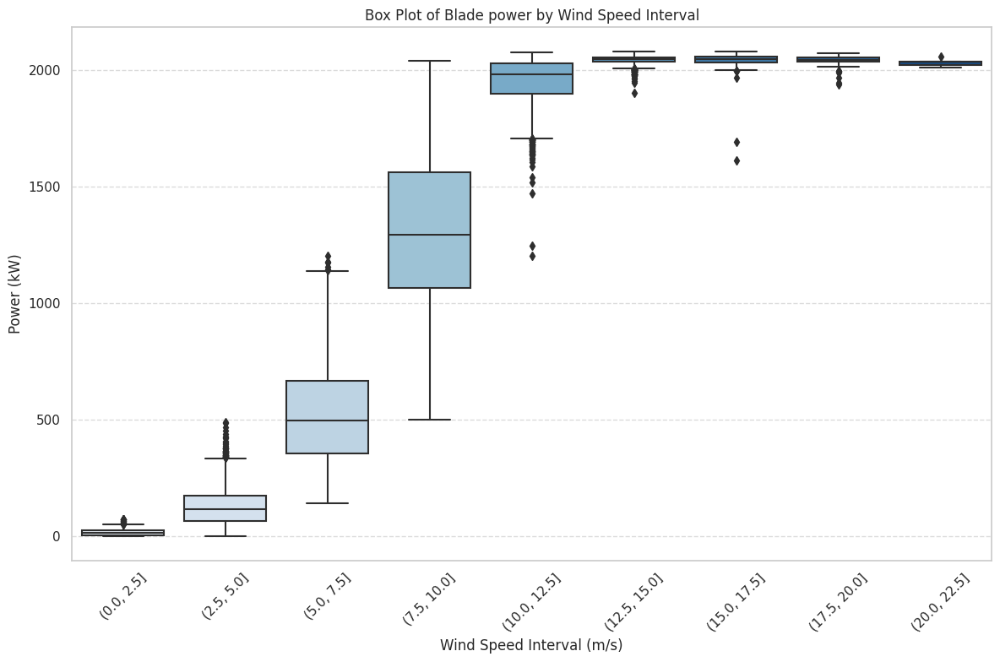

In [84]:
#General Box Plot of Power-in Wind Intervals - Not used



import seaborn as sns
import matplotlib.pyplot as plt

# Define the figure size
plt.figure(figsize=(12, 8))

# Set Seaborn style
sns.set(style="whitegrid")

# Define wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create a new column in the DataFrame to categorize wind speed into intervals
Wind_DC1['Wind Speed Interval'] = pd.cut(Wind_DC1['Wind speed (m/s)'], bins=wind_speed_intervals)

# Customize the color palette
custom_palette = sns.color_palette("Blues", n_colors=9)  # You can adjust the color palette as needed

# Create the box plot
ax = sns.boxplot(data=Wind_DC1, x="Wind Speed Interval", y='Power (kW)', palette=custom_palette)

# Set title, labels, and rotation
ax.set_title("Box Plot of Blade power by Wind Speed Interval")
ax.set_ylabel('Power (kW)')
ax.set_xlabel("Wind Speed Interval (m/s)")
plt.xticks(rotation=45)

# Add grid lines for better readability
ax.yaxis.grid(True, linestyle='--', alpha=0.7)

# If you want to add data points (swarm plot) for each observation, you can uncomment and customize this line
# sns.swarmplot(data=Wind_DC, x="Wind Speed Interval", y="Blade angle (pitch position) A (°)", color="0.2")

# Adjust the plot layout for better spacing
plt.tight_layout()

# If you want to save the plot to a file, uncomment and specify the desired filename
# plt.savefig("boxplot.png", dpi=300)

# Show the plot
plt.show()





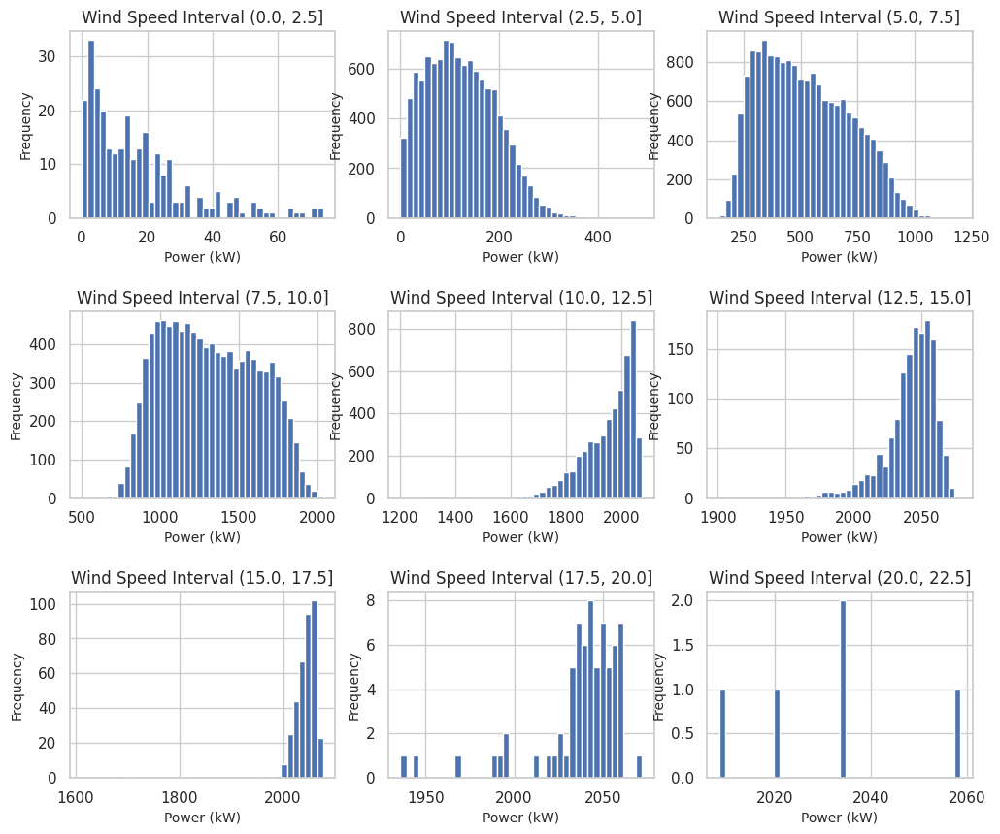

In [85]:
# Frequency Distribution of Power-Wind Interval
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named Wind_DC with the relevant data

# Define wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15,17.5,20,22.5]

# Create a new column in Wind_DC to categorize the data into wind speed intervals
Wind_DC1['Wind Speed Interval'] = pd.cut(Wind_DC1['Wind speed (m/s)'], wind_speed_intervals)

# Initialize a counter to keep track of figures in each row
figure_counter = 0

# Create a subplot with 3 figures per row
fig, axes = plt.subplots(3, 3, figsize=(12, 10))
fig.subplots_adjust(hspace=0.5)

for interval, group in Wind_DC.groupby('Wind Speed Interval'):
    if figure_counter >= 9:
        # Start a new row when reaching the 4th figure in a row
        figure_counter = 0
        fig, axes = plt.subplots(3, 3, figsize=(12, 10))
        fig.subplots_adjust(hspace=0.5)

    ax = axes[figure_counter // 3, figure_counter % 3]
    ax.hist(group['Power (kW)'], bins=40)  # You can adjust the number of bins as needed
    ax.set_title(f'Wind Speed Interval {interval}')
    ax.set_xlabel('Power (kW)', fontsize=10)
    ax.set_ylabel('Frequency', fontsize=10)

    figure_counter += 1

# Ensure that all subplots are utilized even if there are fewer than 9 intervals
for i in range(figure_counter, 9):
    fig.delaxes(axes[i // 3, i % 3])

plt.show()

# Comparing the Power across Different Wind Intervals Before and After Removing The Outliers

In [87]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual1 = go.Scatter(
    x=Wind_SC['Wind speed (m/s)'],
    y=Wind_SC['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=Wind_SC['Wind speed (m/s)'],
        colorscale='Jet',
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=Wind_SC['Wind speed (m/s)'],
    name='Power vs. Wind Speed'
)


# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[Wind_SC['Power (kW)'].min(), Wind_SC['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[Wind_SC['Power (kW)'].min(), Wind_SC['Power (kW)'].max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Power (kW)'),
    legend=dict(x=0.1, y=1.1),
    plot_bgcolor='darkgray',
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=Wind_SC['Power (kW)'].min(),
            y1=Wind_SC['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=Wind_SC['Wind speed (m/s)'].max(),
            y0=Wind_SC['Power (kW)'].min(),
            y1=Wind_SC['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual1,  *vertical_lines], layout=layout)

# Set the figure size
fig.update_layout(width=1200, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


In [88]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual2 = go.Scatter(
    x=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
    y=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
        colorscale='Jet',
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
    name='Power vs. Wind Speed'
)

scatter_trace_potential = go.Scatter(
    x=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
    y=Wind_DC_OutlierRemove_BladePitch_Power['Potential power MPC (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color='black',
        showscale=False,
        opacity=0.5,
    ),
    text=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
    name='Potential Power vs. Wind Speed'
)

# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(), Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(), Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Power (kW)'),
    legend=dict(x=0.1, y=1.1),
    plot_bgcolor='darkgray',
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(),
            y1=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'].max(),
            y0=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(),
            y1=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual2, scatter_trace_potential, *vertical_lines], layout=layout)

# Set the figure size
fig.update_layout(width=1200, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


In [89]:
import plotly.graph_objs as go
import pandas as pd

# Assuming you have already loaded your data into the WindT_P DataFrame

# Define the scatter plot trace with the "jet" color scale
scatter_trace_actual2 = go.Scatter(
    x=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
    y=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'],
    mode='markers',
    marker=dict(
        size=3,
        color=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
        colorscale='Jet',
        showscale=True,
        colorbar=dict(title='Wind speed (m/s)')
    ),
    text=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'],
    name='Power vs. Wind Speed'
)



# Create vertical dashed lines at 3.5 m/s and 22 m/s
vertical_lines = [
    go.Scatter(
        x=[3.5, 3.5],
        y=[Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(), Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max()],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Cut in Wind Speed = 3.5 m/s',
    ),
    go.Scatter(
        x=[22, 22],
        y=[Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(), Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Cut out Wind Speed = 22 m/s',
    )
]

# Create a layout for the figure with a darker background color
layout = go.Layout(
    title='Power vs. Wind Speed',
    xaxis=dict(title='Wind Speed (m/s)'),
    yaxis=dict(title='Power (kW)'),
    legend=dict(x=0.1, y=1.1),
    plot_bgcolor='darkgray',
    shapes=[
        dict(
            type='rect',
            x0=0,
            x1=3.5,
            y0=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(),
            y1=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        ),
        dict(
            type='rect',
            x0=22,
            x1=Wind_DC_OutlierRemove_BladePitch_Power['Wind speed (m/s)'].max(),
            y0=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].min(),
            y1=Wind_DC_OutlierRemove_BladePitch_Power['Power (kW)'].max(),
            fillcolor='white',
            opacity=0.5,
            layer='below',
            line=dict(width=0),
        )
    ]
)

# Create a figure and add the scatter plot trace, vertical lines, and layout
fig = go.Figure(data=[scatter_trace_actual2, *vertical_lines], layout=layout)

# Set the figure size
fig.update_layout(width=1200, height=650)

# Show the plot (you can also save it to a file or display it in a Jupyter Notebook)
fig.show()


#Other Part

In [ ]:
start_datetime = '2020-10-28 08:00:00'
end_datetime = '2020-10-28 10:00:00'

selected_rows = Filtered_Data1 [( Filtered_Data1 ['Date and time'] >= start_datetime) & ( Filtered_Data1 ['Date and time'] <= end_datetime)]
selected_rows = selected_rows.sort_values(by='Date and time')
selected_rows

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
43396,2020-10-28 08:40:00,7.84578,217.752239,210.194824,612.081754,927.490574,-0.394682,11.188889,9.764819,1159.002320,25.417222,10,"(7.5, 10.0]"
43397,2020-10-28 08:50:00,7.77935,221.141599,216.285135,671.459571,905.303002,-0.225220,11.539474,9.975481,1189.422144,21.080526,10,"(7.5, 10.0]"


In [ ]:
start_datetime = '2020-11-11 03:00:00'
end_datetime = '2020-11-11 13:00:00'

selected_rows = Filtered_Data1 [( Filtered_Data1 ['Date and time'] >= start_datetime) & ( Filtered_Data1 ['Date and time'] <= end_datetime)]
selected_rows = selected_rows.sort_values(by='Date and time')
selected_rows

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
45412,2020-11-11 08:40:00,6.450923,171.889047,176.170319,539.582875,505.534458,-0.534456,12.25000,10.201319,1211.819215,18.492000,11,"(5.0, 7.5]"
45413,2020-11-11 08:50:00,6.330106,172.150808,176.170319,235.788551,474.846984,0.068057,12.39500,6.288774,755.018703,35.100500,11,"(5.0, 7.5]"
45417,2020-11-11 09:30:00,6.856080,177.069424,176.170319,163.334935,608.444373,0.523793,12.53000,3.617745,422.241952,66.049999,11,"(5.0, 7.5]"
45424,2020-11-11 10:40:00,8.177056,176.459650,176.170319,607.637421,1049.114007,-0.049182,12.26579,9.575008,1144.392678,21.797000,11,"(7.5, 10.0]"


In [ ]:
# To Consider the Blade Pitch Angle in Working Condition
# Check 1
start_datetime = '2020-01-08 12:00:00'
end_datetime = '2020-01-08 14:00:00'

selected_rows = boxplot_data[( boxplot_data['Date and time'] >= start_datetime) & ( boxplot_data['Date and time'] <= end_datetime)]
selected_rows = selected_rows.sort_values(by='Date and time')
selected_rows


,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
1080,2020-01-08 12:00:00,4.958589,272.904493,257.390625,269.464262,200.403373,-0.921229,13.6850,9.598521,1142.364956,0.000000,1,"(2.5, 5.0]"
1081,2020-01-08 12:10:00,4.575496,269.128455,266.285766,201.918996,157.880053,-0.893079,13.6850,8.980238,1067.919891,0.000000,1,"(2.5, 5.0]"
1082,2020-01-08 12:20:00,4.758931,268.532584,273.854096,185.696965,178.241298,-0.898274,13.9400,8.878728,1056.449049,0.049000,1,"(2.5, 5.0]"
1083,2020-01-08 12:30:00,2.927220,272.586426,273.854096,41.291072,0.000000,-0.205223,14.1475,8.155141,971.920944,0.994009,1,"(2.5, 5.0]"
1084,2020-01-08 12:40:00,3.997701,266.922661,273.854096,113.928085,93.829884,-0.734104,14.1625,8.341365,993.475702,0.370990,1,"(2.5, 5.0]"
1085,2020-01-08 12:50:00,5.570092,276.570451,273.854096,87.270465,311.037185,0.269702,14.2025,3.716513,448.550347,57.419112,1,"(5.0, 7.5]"
1086,2020-01-08 13:00:00,4.831675,271.456227,273.854096,41.925584,186.315926,0.623147,14.2050,2.746085,333.943383,59.869854,1,"(2.5, 5.0]"
1087,2020-01-08 13:10:00,3.747961,277.577332,273.854096,100.720003,75.349131,-0.791049,14.0200,8.239210,980.211147,0.394494,1,"(2.5, 5.0]"
1088,2020-01-08 13:20:00,2.695449,291.789542,273.854096,23.489050,0.000000,-0.679378,14.0500,8.140193,970.243286,1.207502,1,"(2.5, 5.0]"
1089,2020-01-08 13:30:00,2.423712,290.079739,273.854096,6.923044,0.000000,-0.537898,14.2400,8.150848,970.152145,1.415002,1,"(0.0, 2.5]"


In [ ]:
# To Define Function Blade_Pitch_Outlier_Detection
def Blade_Pitch_Outlier_Detection (start_datetime, end_datetime):
  selected_rows = boxplot_data[( boxplot_data['Date and time'] >= start_datetime) & ( boxplot_data['Date and time'] <= end_datetime)]
  selected_rows = selected_rows.sort_values(by='Date and time')
  return selected_rows

In [ ]:
# Check 2
start_datetime = '2020-02-05 06:00:00'
end_datetime = '2020-02-05 08:00:00'
Blade_Pitch_Outlier_Detection (start_datetime, end_datetime)

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
5076,2020-02-05 06:00:00,4.116482,305.738807,304.585907,112.610895,106.929557,-0.816314,6.957895,8.148858,970.214551,0.077368,2,"(2.5, 5.0]"
5077,2020-02-05 06:10:00,3.943090,298.375112,304.585907,92.097574,89.788678,-0.652726,7.175000,8.135133,969.617912,0.246996,2,"(2.5, 5.0]"
5078,2020-02-05 06:20:00,3.208238,299.372246,304.585907,29.935001,35.409608,-0.292784,7.060000,8.140558,969.934799,1.215000,2,"(2.5, 5.0]"
5082,2020-02-05 07:00:00,4.264166,278.522143,281.269912,89.027881,123.322476,-0.048892,7.075000,5.867693,701.324466,15.315998,2,"(2.5, 5.0]"
5083,2020-02-05 07:10:00,4.677831,278.386360,284.829742,173.305022,169.239252,-0.932015,6.877500,8.551188,1017.683023,0.000000,2,"(2.5, 5.0]"
5084,2020-02-05 07:20:00,4.849200,291.747323,284.829742,202.363521,188.261209,-0.940665,6.825000,8.893632,1061.037689,0.000000,2,"(2.5, 5.0]"
5085,2020-02-05 07:30:00,4.410772,301.785911,284.829742,169.747933,139.595737,-0.926410,6.730000,8.566294,1019.019470,0.000000,2,"(2.5, 5.0]"
5086,2020-02-05 07:40:00,3.745307,294.642391,284.829742,83.562044,75.152700,-0.827192,6.715000,8.137116,969.563936,0.393999,2,"(2.5, 5.0]"
5087,2020-02-05 07:50:00,3.706427,290.668695,284.829742,74.207866,72.275611,-0.825345,6.605263,8.157292,970.422243,0.700526,2,"(2.5, 5.0]"
5088,2020-02-05 08:00:00,4.110208,281.235568,284.829742,95.881898,106.233128,-0.850341,6.682500,8.136536,969.872601,0.171500,2,"(2.5, 5.0]"


In [ ]:
# Check 3
start_datetime = '2020-03-25 08:30:00'
end_datetime = '2020-03-25 10:30:00'
Blade_Pitch_Outlier_Detection (start_datetime,end_datetime )

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
12147,2020-03-25 08:30:00,3.497052,180.784721,169.585983,83.589787,56.781844,-0.722719,8.7500,8.172959,971.983446,0.492498,3,"(2.5, 5.0]"
12148,2020-03-25 08:40:00,3.842723,178.268791,169.585983,119.948530,82.361482,-0.821488,9.2625,8.247613,982.628569,0.201494,3,"(2.5, 5.0]"
12149,2020-03-25 08:50:00,4.116687,180.462512,169.585983,131.981294,106.952226,-0.853887,9.7325,8.335855,993.886745,0.147498,3,"(2.5, 5.0]"
12150,2020-03-25 09:00:00,3.712655,185.072278,169.585983,112.011635,72.736492,-0.865409,10.0400,8.244960,982.411148,0.245000,3,"(2.5, 5.0]"
12151,2020-03-25 09:10:00,3.794163,186.439927,169.585983,98.232118,78.768081,-0.743622,10.5275,8.242082,981.776951,0.456493,3,"(2.5, 5.0]"
12152,2020-03-25 09:20:00,3.520404,186.830937,169.585983,66.535370,58.509862,-0.704189,11.0450,8.138972,969.435957,0.664998,3,"(2.5, 5.0]"
12153,2020-03-25 09:30:00,3.637686,187.336895,173.338881,6.089919,67.188732,0.815783,11.3700,1.093420,129.649550,76.022063,3,"(2.5, 5.0]"
12154,2020-03-25 09:40:00,2.744940,181.406809,178.137355,35.150062,0.000000,-0.245346,11.6800,6.693076,796.266770,11.101437,3,"(2.5, 5.0]"
12156,2020-03-25 10:00:00,3.635213,188.504170,181.461412,19.974005,67.005793,0.614036,12.4975,2.663442,322.878062,55.408789,3,"(2.5, 5.0]"
12157,2020-03-25 10:10:00,3.101225,188.015130,186.048920,44.901718,27.490663,-0.658889,12.8725,8.141036,969.420158,0.940000,3,"(2.5, 5.0]"


In [ ]:
# Check 4
start_datetime = '2020-10-28 08:00:00'
end_datetime = '2020-10-28 09:50:00'

Blade_Pitch_Outlier_Detection (start_datetime,end_datetime )


,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
43392,2020-10-28 08:00:00,7.535008,208.376188,210.194824,940.761578,823.692760,-0.941595,10.292500,13.857585,1646.454369,0.000000,10,"(7.5, 10.0]"
43393,2020-10-28 08:10:00,8.112005,215.789964,210.194824,1098.720587,1023.353978,-0.950221,10.472500,14.596102,1733.681751,0.000000,10,"(7.5, 10.0]"
43394,2020-10-28 08:20:00,7.532688,220.716480,210.194824,1027.681125,822.917775,-0.944496,10.607500,14.103153,1675.533651,0.000000,10,"(7.5, 10.0]"
43395,2020-10-28 08:30:00,7.747215,215.023926,210.194824,1018.742303,894.569733,-0.954936,10.805000,14.210371,1689.232384,0.000000,10,"(7.5, 10.0]"
43396,2020-10-28 08:40:00,7.845780,217.752239,210.194824,612.081754,927.490574,-0.394682,11.188889,9.764819,1159.002320,25.417222,10,"(7.5, 10.0]"
43397,2020-10-28 08:50:00,7.779350,221.141599,216.285135,671.459571,905.303002,-0.225220,11.539474,9.975481,1189.422144,21.080526,10,"(7.5, 10.0]"
43398,2020-10-28 09:00:00,7.635246,220.681553,221.185042,915.998138,857.172073,-0.947637,11.587500,13.834949,1643.907171,0.000000,10,"(7.5, 10.0]"
43399,2020-10-28 09:10:00,7.099049,225.777221,225.560730,815.646367,678.082508,-0.924924,11.787500,13.382189,1587.742212,0.000000,10,"(5.0, 7.5]"
43400,2020-10-28 09:20:00,6.845411,215.672236,225.560730,692.149350,605.734495,-0.912906,11.957500,12.595770,1499.367714,0.000000,10,"(5.0, 7.5]"
43401,2020-10-28 09:30:00,7.916059,221.597392,219.377604,1056.459930,950.963791,-0.935363,12.050000,14.106007,1675.282454,0.041500,10,"(7.5, 10.0]"


In [ ]:
start_datetime = '2020-11-11 08:00:00'
end_datetime = '2020-11-11 12:30:00'
Blade_Pitch_Outlier_Detection (start_datetime, end_datetime)

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
45408,2020-11-11 08:00:00,5.757445,186.307128,167.389801,506.948669,345.884710,-0.913854,12.12750,11.618041,1381.103634,0.000000,11,"(5.0, 7.5]"
45409,2020-11-11 08:10:00,7.227929,183.629987,181.952935,868.129559,721.128245,-0.947094,12.06000,13.565305,1612.109602,0.000000,11,"(5.0, 7.5]"
45410,2020-11-11 08:20:00,7.564708,178.985607,176.170319,799.123888,833.612590,-0.934971,12.20000,13.353263,1588.271009,0.000000,11,"(7.5, 10.0]"
45411,2020-11-11 08:30:00,7.172149,170.818280,176.170319,792.468066,702.497612,-0.943126,12.15250,13.296582,1581.314472,0.000000,11,"(5.0, 7.5]"
45412,2020-11-11 08:40:00,6.450923,171.889047,176.170319,539.582875,505.534458,-0.534456,12.25000,10.201319,1211.819215,18.492000,11,"(5.0, 7.5]"
45413,2020-11-11 08:50:00,6.330106,172.150808,176.170319,235.788551,474.846984,0.068057,12.39500,6.288774,755.018703,35.100500,11,"(5.0, 7.5]"
45414,2020-11-11 09:00:00,6.563391,173.900507,176.170319,611.729279,534.101415,-0.923224,12.49500,12.325022,1464.927114,0.000000,11,"(5.0, 7.5]"
45415,2020-11-11 09:10:00,6.370954,172.273303,176.170319,549.194916,485.222307,-0.892538,12.49250,11.819083,1407.330208,0.000000,11,"(5.0, 7.5]"
45416,2020-11-11 09:20:00,6.820853,172.073537,176.170319,760.878627,599.496709,-0.922912,12.62250,13.161121,1562.610466,0.000000,11,"(5.0, 7.5]"
45417,2020-11-11 09:30:00,6.856080,177.069424,176.170319,163.334935,608.444373,0.523793,12.53000,3.617745,422.241952,66.049999,11,"(5.0, 7.5]"


In [ ]:
#How to remove the rows of filtered_data2 from filtered_data
# Identify the common indices (rows) between the two DataFrames
common_indices = boxplot_data.index.intersection(Filtered_Data1.index)

# Remove rows from filtered_data based on common indices
boxplot_data = boxplot_data.drop(common_indices)

In [ ]:
# Box Plot Data 3 - Power

# Define the wind speed intervals
wind_speed_intervals = [0, 2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5]

# Create a new column in the DataFrame to categorize wind speed into intervals
boxplot_data['Wind Speed Interval'] = pd.cut(boxplot_data['Wind speed (m/s)'], bins=wind_speed_intervals)

# Create a scatter plot using Plotly Express
fig = px.scatter(boxplot_data, x='Wind speed (m/s)', y='Power (kW)', color='Wind Speed Interval')

# Set plot title and labels
fig.update_layout(
    title='Scatter Plot of Wind Speed vs. Power Output',
    xaxis_title='Wind Speed (m/s)',
    yaxis_title='Power Output (kW)'
)

# Show the plot
fig.show()

In [ ]:
start_datetime = '2020-12-29 12:00:00'
end_datetime = '2020-12-29 22:50:00'
Blade_Pitch_Outlier_Detection(start_datetime, end_datetime)

,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month,Wind Speed Interval
52397,2020-12-29 20:50:00,7.806578,298.956124,302.389740,500.408110,914.396946,-0.883805,2.7125,10.076616,1200.274881,8.219,12,"(7.5, 10.0]"
52398,2020-12-29 21:00:00,7.464879,301.285405,302.389740,846.446713,800.269622,-0.942517,2.7350,13.252334,1576.551390,0.264,12,"(5.0, 7.5]"
52399,2020-12-29 21:10:00,7.022516,303.297064,302.389740,754.359375,652.520404,-0.938280,2.7975,13.043742,1549.816715,0.000,12,"(5.0, 7.5]"
52400,2020-12-29 21:20:00,7.090696,308.273542,302.389740,757.921780,675.292560,-0.933868,2.7950,13.056334,1552.519072,0.000,12,"(5.0, 7.5]"
52401,2020-12-29 21:30:00,8.034061,304.648932,302.389740,1016.043170,992.488176,-0.952410,2.8100,14.203842,1688.503344,0.000,12,"(7.5, 10.0]"
52402,2020-12-29 21:40:00,9.076735,300.502654,302.389740,1324.290533,1407.228778,-0.966360,2.8075,15.126691,1798.306131,0.000,12,"(7.5, 10.0]"
52403,2020-12-29 21:50:00,8.447986,294.771439,295.684701,1184.584253,1156.402591,-0.963212,2.7150,14.934348,1775.787615,0.000,12,"(7.5, 10.0]"
52404,2020-12-29 22:00:00,8.293323,299.758367,300.881731,1241.583789,1095.156094,-0.960793,2.7225,14.969196,1778.979321,0.000,12,"(7.5, 10.0]"
52405,2020-12-29 22:10:00,8.284024,296.728349,302.389740,1144.137100,1091.473429,-0.956875,2.8400,14.843315,1762.015068,0.000,12,"(7.5, 10.0]"
52406,2020-12-29 22:20:00,7.961760,299.663961,302.389740,1108.688614,966.227871,-0.955480,2.8125,14.705821,1748.302122,0.000,12,"(7.5, 10.0]"


In [ ]:
start_datetime = '2020-12-29 20:30:00'
end_datetime = '2020-12-29 23:30:00'

selected_rows = Wind_SC[( Wind_SC['Date and time'] >= start_datetime) & ( Wind_SC['Date and time'] <= end_datetime)]
selected_rows = selected_rows.sort_values(by='Date and time')
selected_rows


,Date and time,Wind speed (m/s),Wind direction (°),Nacelle position (°),Power (kW),Potential power MPC (kW),Power factor (cosphi),Ambient temperature (converter) (°C),Rotor speed (RPM),Gearbox speed (RPM),Blade angle (pitch position) A (°),Month
52395,2020-12-29 20:30:00,7.779094,307.832533,302.389740,-1.271331,905.217310,1.000000,2.787500,0.000000,10.453043,89.989998,12
52396,2020-12-29 20:40:00,8.277705,297.724624,302.389740,129.902667,1088.971341,0.466739,2.777500,3.632394,438.048792,56.940999,12
52397,2020-12-29 20:50:00,7.806578,298.956124,302.389740,500.408110,914.396946,-0.883805,2.712500,10.076616,1200.274881,8.219000,12
52398,2020-12-29 21:00:00,7.464879,301.285405,302.389740,846.446713,800.269622,-0.942517,2.735000,13.252334,1576.551390,0.264000,12
52399,2020-12-29 21:10:00,7.022516,303.297064,302.389740,754.359375,652.520404,-0.938280,2.797500,13.043742,1549.816715,0.000000,12
52400,2020-12-29 21:20:00,7.090696,308.273542,302.389740,757.921780,675.292560,-0.933868,2.795000,13.056334,1552.519072,0.000000,12
52401,2020-12-29 21:30:00,8.034061,304.648932,302.389740,1016.043170,992.488176,-0.952410,2.810000,14.203842,1688.503344,0.000000,12
52402,2020-12-29 21:40:00,9.076735,300.502654,302.389740,1324.290533,1407.228778,-0.966360,2.807500,15.126691,1798.306131,0.000000,12
52403,2020-12-29 21:50:00,8.447986,294.771439,295.684701,1184.584253,1156.402591,-0.963212,2.715000,14.934348,1775.787615,0.000000,12
52404,2020-12-29 22:00:00,8.293323,299.758367,300.881731,1241.583789,1095.156094,-0.960793,2.722500,14.969196,1778.979321,0.000000,12


In [ ]:
#Time Vs Wind Speed in a Month
# The Graph for Each Month
import matplotlib.pyplot as plt
import pandas as pd


# Assuming "Date and time" column is in the datetime format, if not, you can convert it using pd.to_datetime()
Monthly_Data_6['Date and time'] = pd.to_datetime(Monthly_Data_6['Date and time'])

# Extract the date and time values for the x-axis
date_time = Monthly_Data_6['Date and time']

# Extract the wind speed values for the y-axis
wind_speed = Monthly_Data_6['Rotor speed (RPM)']

# Create the line plot
plt.figure(figsize=(12, 6))
plt.plot(date_time, wind_speed, label='Wind Speed (m/s)')
plt.title('Wind Speed for Month 6')
plt.xlabel('Date and Time')
plt.ylabel('Wind Speed (m/s)')
plt.grid(True)
plt.legend()
plt.tight_layout()

# Show the plot
plt.show()